# Case Study 3 - Ahmad Abbas - 1190245
---
For this case study, we explore and compare the performace of the clustering algorithms we discussed in the lab - K-means, Gaussian Mixture Model (GMM), and DBSCAN - in the context of image segmentation on a set of different images. Also we are exploring the effect of standardization and coordinates augmentation. We've coded two modules _ImageClustering_ and _DBCAN_ modules which provide all the needed functionality, so we can clearly view the results not the code itself. 

In [1]:
from ImageClustering import ImageClustering, ClusteringAlgorithm, EvaluationMetric

## Clustering Pipeline
---
This pipline walks through all the configurations we want and provides the resutls for each of them so we can write out comments on them.

In [2]:
import matplotlib.pyplot as plt

def clustering_pipeline(image_path, metric=EvaluationMetric.DAVIES_BOULDIN, algorithms = ['kmeans', 'gmm'],  n_clusters_range = range(2, 8)):
    preprocess_options = [
        {'use_standardization': True, 'augment_with_coordinates': True},
        {'use_standardization': False, 'augment_with_coordinates': True},
        {'use_standardization': True, 'augment_with_coordinates': False},
        {'use_standardization': False, 'augment_with_coordinates': False}
    ]

    for preprocess_kwargs in preprocess_options:
        preprocess_title = f"Std: {preprocess_kwargs['use_standardization']}, Coords: {preprocess_kwargs['augment_with_coordinates']} "

        for algo in algorithms:
            fig, axs = plt.subplots(1, len(n_clusters_range) + 2, figsize=(15, 3))
            fig.suptitle(f"{algo.upper()} Results - {preprocess_title}", fontsize=16)

            clustering = ImageClustering(image_path, algo)
            if metric==EvaluationMetric.DAVIES_BOULDIN:
                best_score = 10
            else:
                best_score = -10
                
            best_image = []
            best_cluster = 2
            for j, n_clusters in enumerate(n_clusters_range):
                clustered_image, colored_image = clustering.cluster_image(n_clusters=n_clusters, preprocess_kwargs=preprocess_kwargs)
                score = clustering.evaluate_clustering(n_clusters=n_clusters, preprocess_kwargs=preprocess_kwargs, metric=metric)
                    
                if metric==EvaluationMetric.DAVIES_BOULDIN and score < best_score:
                    best_image = colored_image
                    best_score = score
                    best_cluster = n_clusters
                elif metric==EvaluationMetric.SILHOUETTE and score > best_score:
                    best_image = colored_image
                    best_score = score
                    best_cluster = n_clusters
                
                ax = axs[j]
                ax.imshow(clustered_image)
                ax.set_title(f"Clus: {n_clusters}, S: {score:.2f}")
                ax.axis('off')

            ax = axs[len(n_clusters_range)]
            ax.imshow(best_image)
            ax.set_title(f"Best Clustered Image {best_cluster}")
            ax.axis('off')
            
            ax = axs[len(n_clusters_range) + 1]
            ax.imshow(clustering.image)
            ax.set_title(f"Original Image")
            ax.axis('off')
            
            plt.tight_layout(rect=[0, 0.03, 1, 0.95])
            plt.show()


## Clustering Metrics
---

### Silhouette Score

The silhouette score is a measure used to evaluate the quality of clusters in a dataset. It quantifies both the compactness and the separation of clusters. The silhouette score, $ S $, for each sample is calculated using the following formula:

$$
S = \frac{b - a}{\max(a, b)}
$$

where:
- $a $ is the mean distance between a sample and all other points in the same cluster.
- $ b $ is the mean distance between a sample and all other points in the next nearest cluster.

The silhouette score ranges from -1 to 1, where a high value indicates that the object is well matched to its own cluster and poorly matched to neighboring clusters. If most objects have a high value, then the clustering configuration is appropriate [See here](https://scikit-learn.org/stable/modules/clustering.html#silhouette-coefficient).



---

### Davies-Bouldin Index

The Davies-Bouldin Index (DBI) is an internal evaluation scheme for clustering algorithms which is based on the measurement of the average similarity between each cluster and its most similar one. The Davies-Bouldin index is defined as:

$$
DB = \frac{1}{n} \sum_{i=1}^{n} \max_{i \neq j} \left( \frac{\sigma_i + \sigma_j}{d(c_i, c_j)} \right)
$$


where:
- $ n $ is the number of clusters.
- $ \sigma_i $ is the average distance of all points in cluster $i$ to the centroid $c_i$ of cluster $i$.
- $ d(c_i, c_j) $ is the distance between centroids $ c_i $ and $c_j $.
- The ratio $ \frac{\sigma_i + \sigma_j}{d(c_i, c_j)} $ encapsulates the similarity between clusters $i$ and $j$.

A lower Davies-Bouldin index relates to a model with better separation between the clusters [See here](https://scikit-learn.org/stable/modules/clustering.html#davies-bouldin-index).


---

## Images Discussion 
## First Image
### Kmeans
The first image is full of different colors and patterns. In our K-means clustering test, the top row of images scored high on the Davies-Bouldin index, which is not good because lower scores are better. These images divided the original picture effectively but failed to separate two colors that should be distinct. When we didn't standardize the data, the images didn't look as nice, yet their scores improved. This could be because the image has a lot of colors. Without using coordinates, the clustering often appeared better. This suggests that including coordinates might mix the cluster too much if we're not careful.  Skippnig both standardization and coordinates resulted in clusters that were almost identical to those produced without coordinates alone. This indicates that without coordinates, standardization doesn’t make much difference.

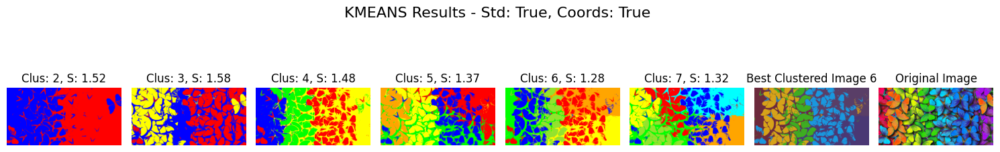

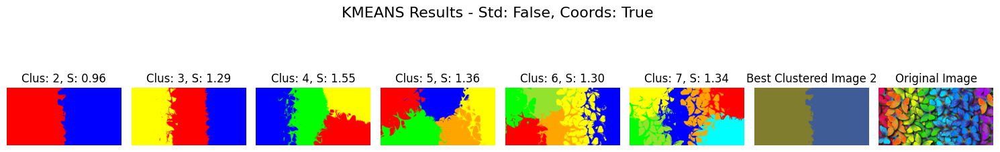

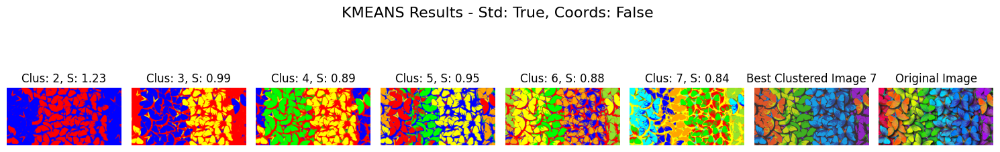

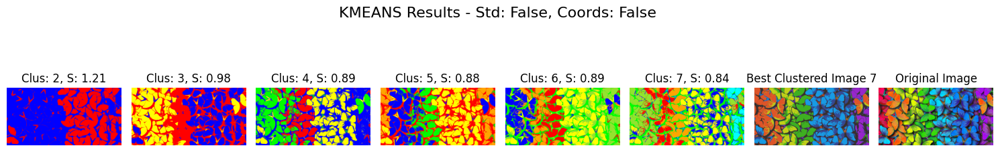

In [3]:
clustering_pipeline('1.jpg', algorithms = ['kmeans'])

### GMM
In the first row, where we applied both standardization and coordinates, the scores were high. The best image in this group accurately represented some parts, but it incorrectly mixed some colors that should have been separated. When we skipped standardization but kept using coordinates, the clustering in the image weren't clear to our eyes, yet the scores were lower. This suggests that the Gaussian Mixture Model (GMM) is more effective than K-Means at identifying mixed clusters when we don't standardize. Not using coordinates seems beneficial, as the third row, which used standardization without coordinates, displayed clearer clustering and also received good scores. The last set, which didn't use either standardization or coordinates,  looks a lot like the third set. This hints that not using coordinates is the key factor, and standardization by itself doesn't make a significant differnce.

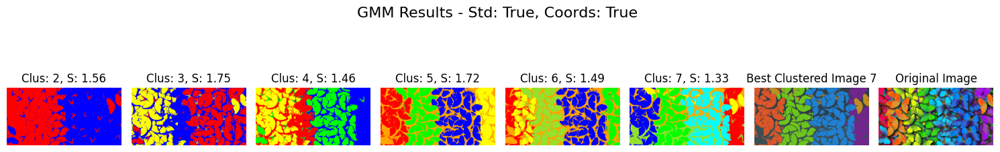

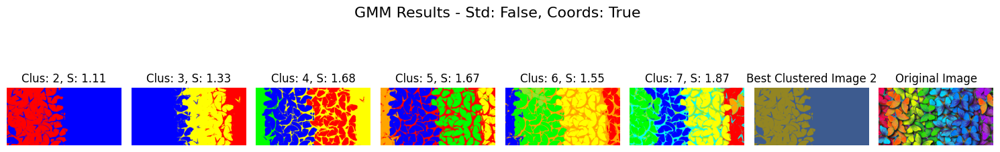

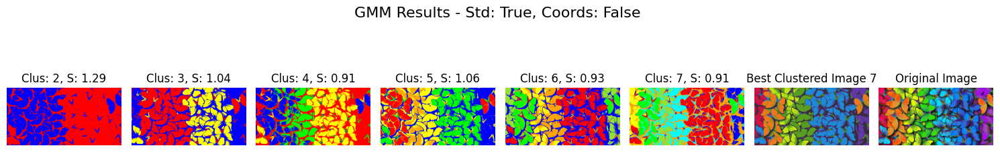

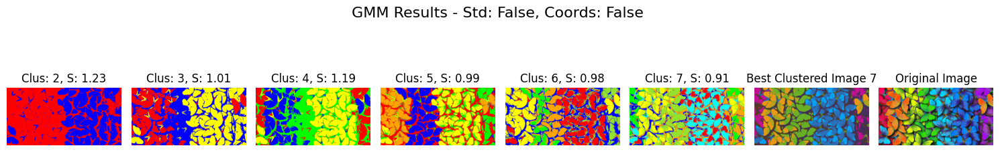

In [4]:
clustering_pipeline('1.jpg', algorithms = ['gmm'])

### Using SILHOUETTE

In the Kmeans analysis using standardization and coordinates, the silhouette scores are generally lower compared to when these methods aren't applied. This suggests that the model is less effective at segmenting colors when we standardize the data and include coordinates.

Similarly, in the Gaussian Mixture Model (GMM), using standardization and coordinates often leads to poorer silhouette scores. However, these scores are even lower than those from K-means, suggesting that K-means may be better in clustering this specific type of data.

Regarding these images, it's noticeable that the colors are already clusterd together; each color is concentrated in a certain area of the image. Therefore, coordinates might not have as significant an impact as standardization. In simpler terms, since the colors are already naturally clustered  in the image, adding coordinates doesn’t change things much, but changing the scale of the data (standardization) does.

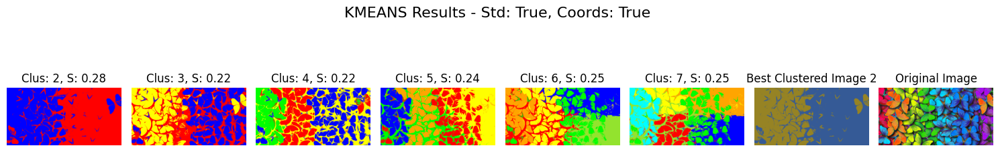

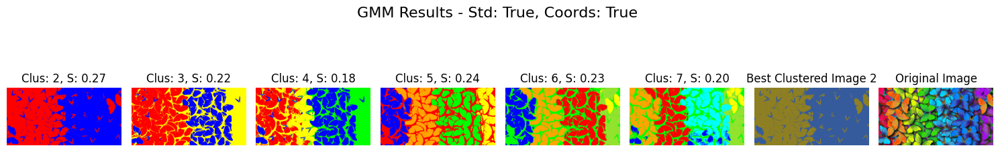

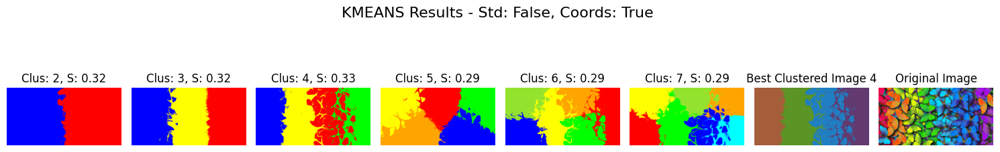

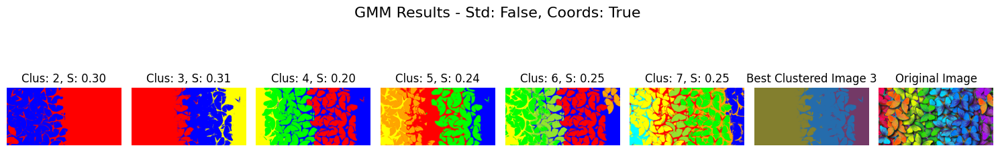

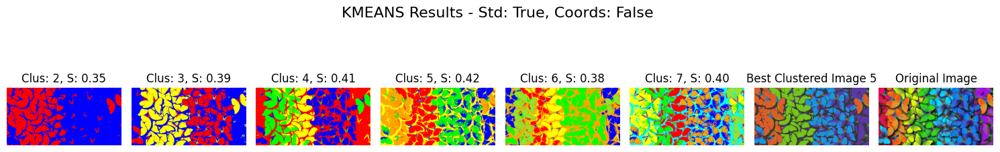

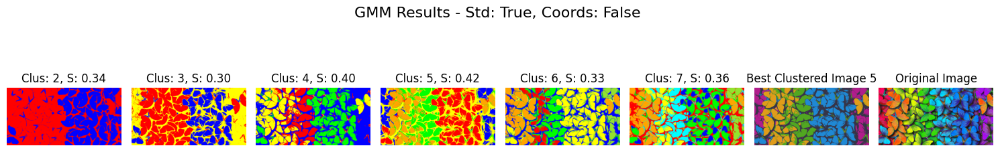

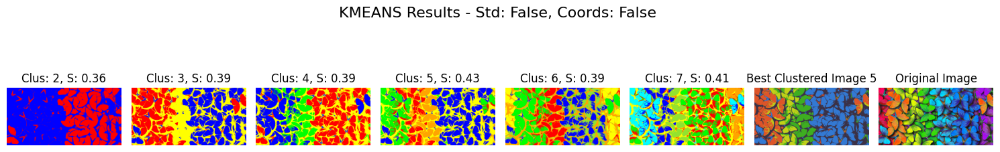

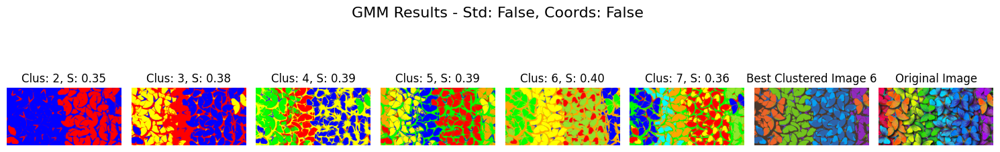

In [5]:
clustering_pipeline('1.jpg', metric=EvaluationMetric.SILHOUETTE)

## Second Image
This image have the same architecture of the previous image with the same results and notes.

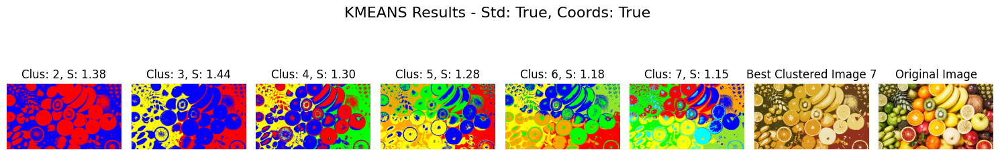

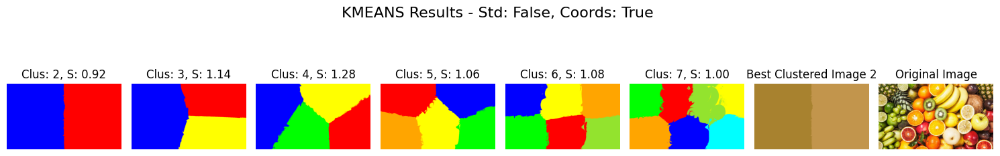

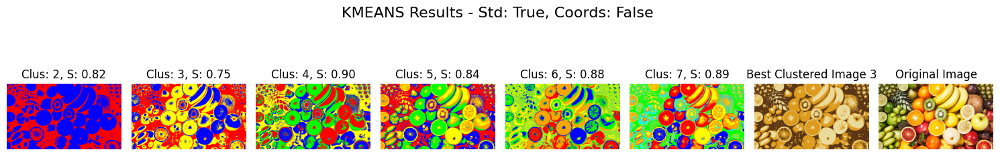

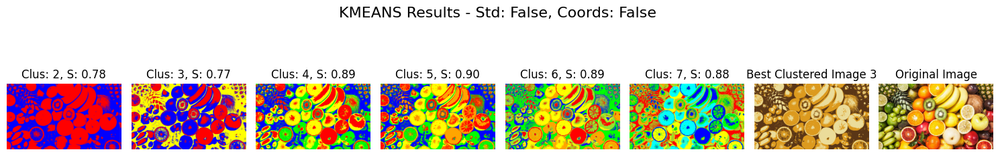

In [6]:
clustering_pipeline('2.jpg', algorithms = ['kmeans'])

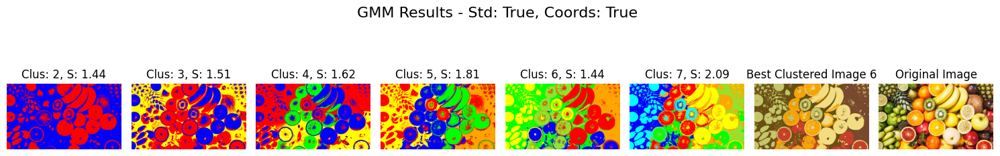

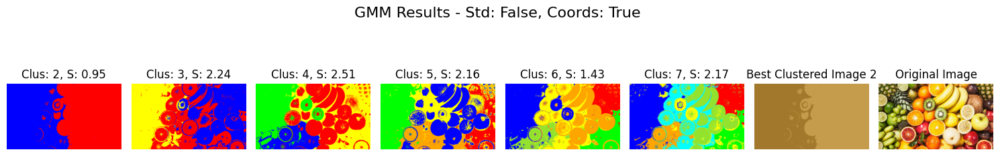

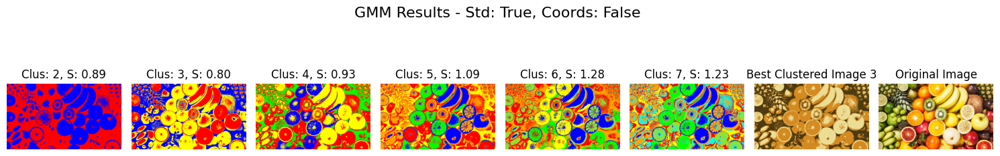

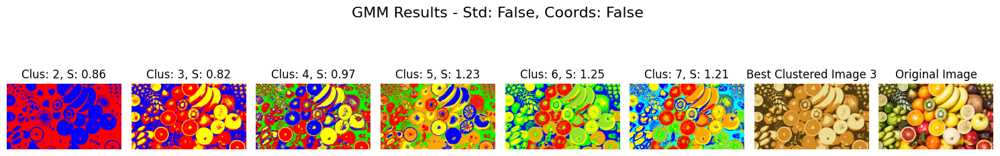

In [7]:
clustering_pipeline('2.jpg', algorithms = ['gmm'])

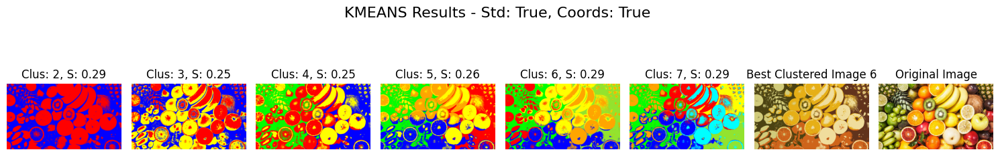

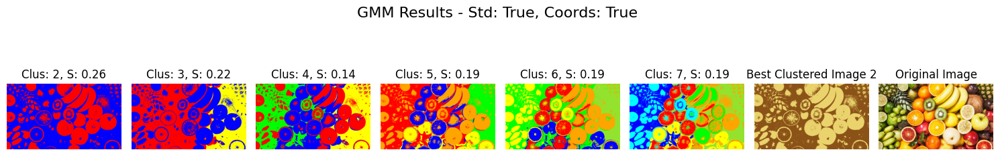

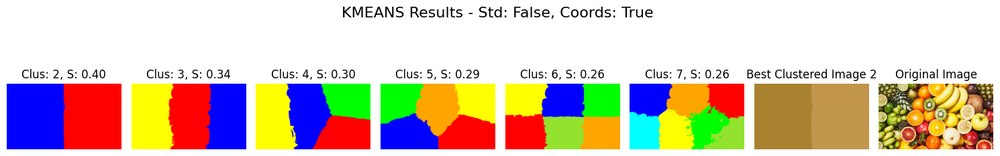

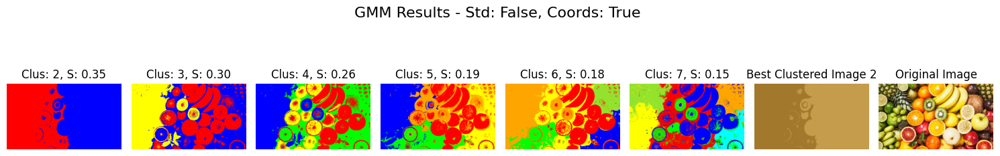

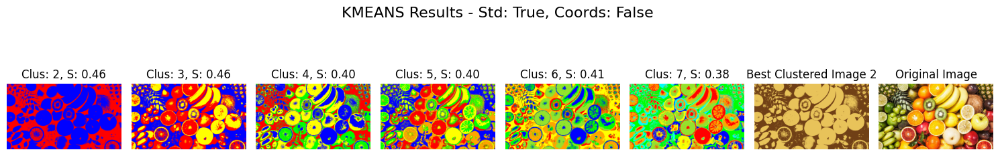

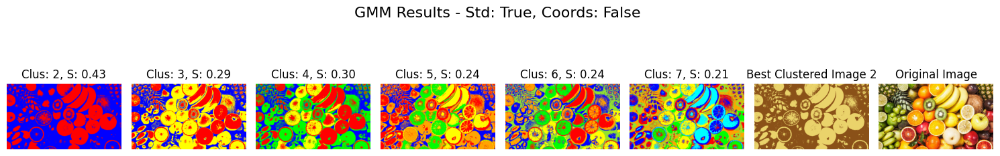

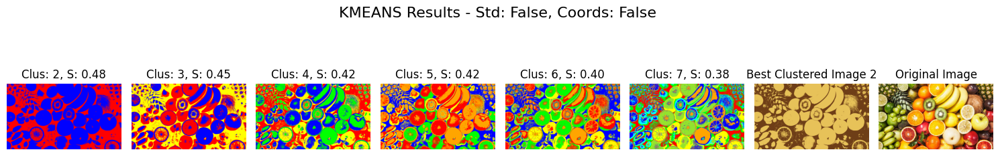

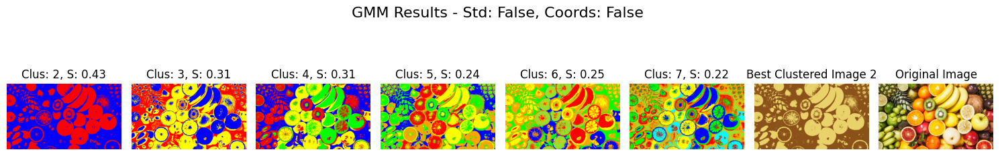

In [8]:
clustering_pipeline('2.jpg', metric=EvaluationMetric.SILHOUETTE)

## Third Image
### Kmeans

The image presents a scenario with more consistent colors than the previous ones, which had overlapping colors and light. This means we're not only using colors to differentiate the clusters but also considering how adding coordinates to the features affects the clustering. When we used both standardization and coordinates, we got good results with reasonable scores. As expected, when we skipped standardization but kept coordinates, the clusters were not effective, indicating that using coordinates alone can lead to poor clustering. Conversely, applying standardization without coordinates resulted in much better results, showing patterns that weren't visible in the first attempt. Finally, without either standardization or coordinates, there was a small improvement in the scores. This suggests that including coordinates isn't always beneficial and might even be worse if not combined with standardization. The slight improvement in scores without both methods suggests that, for this particular set of data, the role of coordinates is not critical.

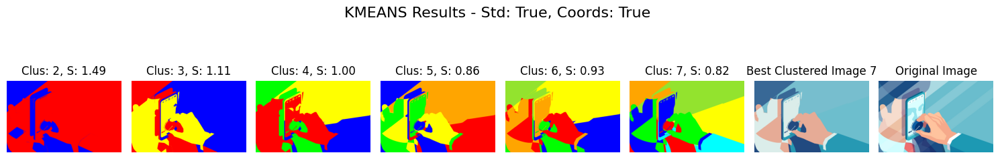

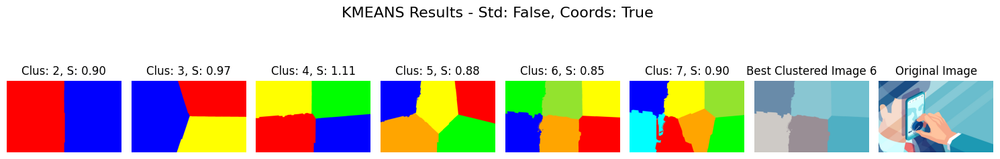

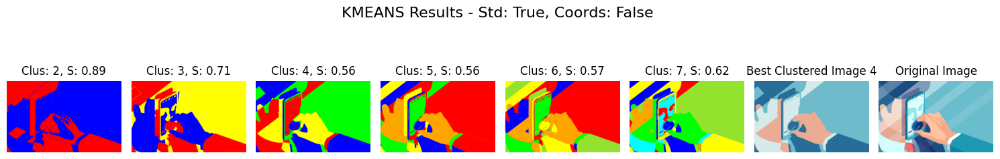

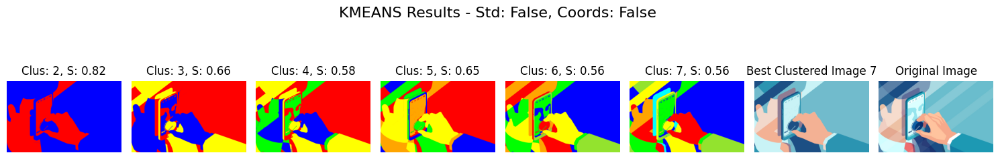

In [9]:
clustering_pipeline('3.jpg', algorithms = ['kmeans'])

### GMM
For (GMM),  we have much worse scores, but we can see better representation of specific details like the face inside the phone with using both standardization and coordinates. However, when we didn't use standardization but kept coordinates, it resulted in a poor visual outcome despite a better score. Without both standardization and coordinates, the visual result was similar to that of K-means, but with a lower score.

Additionally, it's noticeable that GMM captures light rays in the image more effectively than K-means. Each Gaussian (or 'cluster') in the mixture can have its own unique mean and covariance structure. This capability allows GMMs to model a wide variety of distributions, including those that are elongated or have different variances. Due to this flexibility, GMMs are particularly skilled at capturing complex and overlapping clusters, such as the varying intensities and orientations of light rays in an image. This aspect makes GMMs a more suitable choice for images with intricate light patterns.

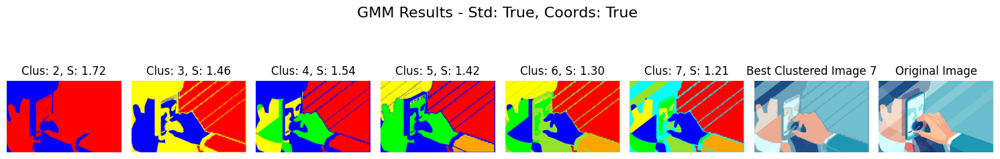

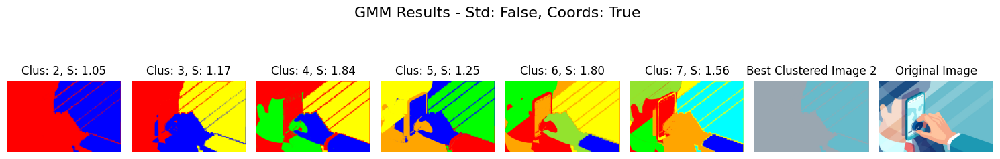

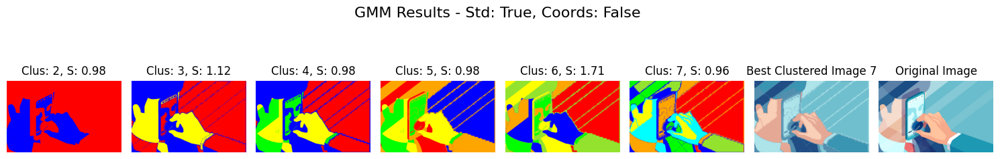

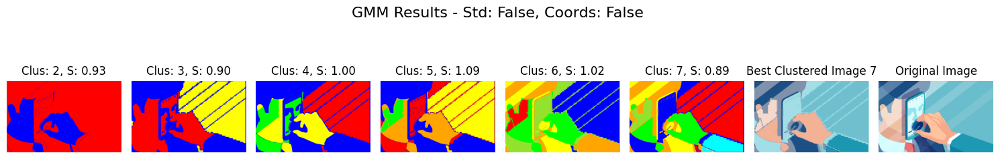

In [10]:
clustering_pipeline('3.jpg', algorithms = ['gmm'])

For this particular image, using coordinates without standardization led to worse results. Generally, this issue is observed when coordinates are used without standardization, often resulting in very poor outcomes. This suggests that the coordinates can overpower the feature space due to their relatively larger numerical values, which could skew the model's learning process.

#### Silhouette Scores
The silhouette method provided better results for images with a high number of clusters. Without standardization, the silhouette scores accurately identified the best result, outperforming the Davies-Bouldin Index. Silhouette scores are generally more effective for clustering images with overlapping clusters compared to the Davies-Bouldin Index. This is because silhouette scores measure how similar an object is to its own cluster versus other clusters. This method effectively captures both separation and cohesion, even in scenarios where clusters overlap. On the other hand, the Davies-Bouldin Index focuses on within-cluster distances and the maximum similarity between clusters. This approach can be less effective in distinguishing overlapping clusters, as it might not adequately penalize overlap.

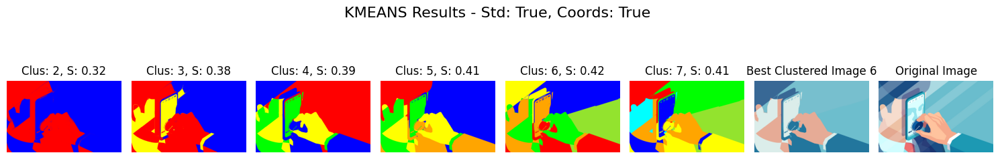

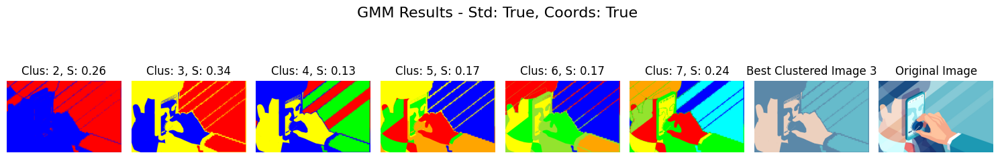

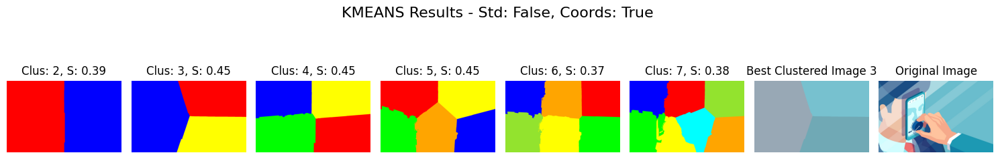

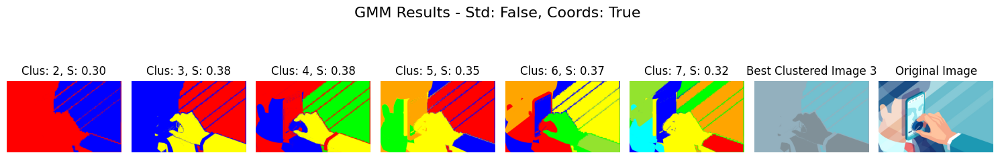

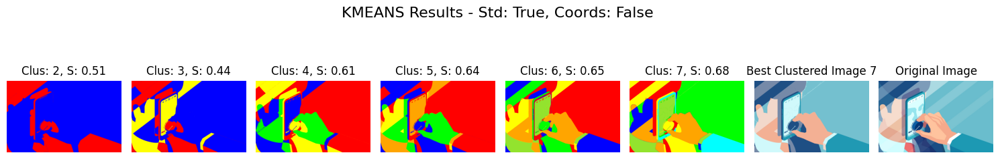

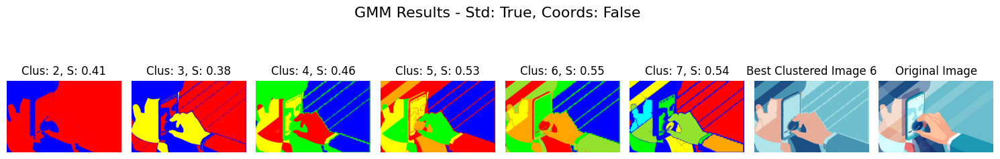

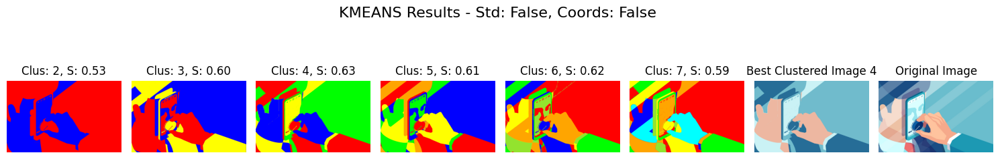

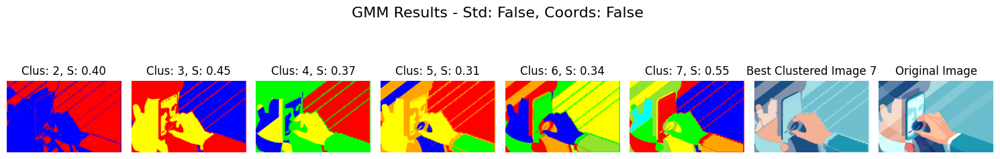

In [11]:
clustering_pipeline('3.jpg', metric=EvaluationMetric.SILHOUETTE)

## Fourth Image
### Kmeans
This image shows the task of separating the background from the main object, in this case, Linus Torvalds. Ideally, optimal segmentation would result in 2 or 3 clusters. When using both standardization and coordinates, the model accurately segmented Linus, though not completely. However, without standardization, the model confused the background with Linus, indicating an overemphasis on the coordinate features in this setup. Without coordinates, the best segmentation was achieved with 2 clusters, but Linus was still not fully segmented. The results were nearly identical when neither standardization nor coordinates were used. 

These observations suggest that using coordinates without standardization can mislead the model due to an imbalance in feature influence, whereas incorporating standardization yields better results, likely due to the nature of this particular image.

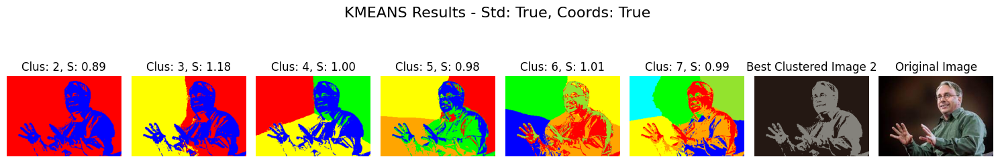

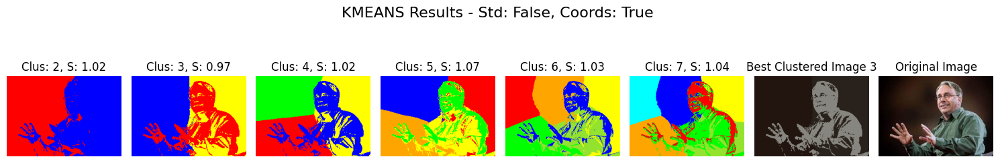

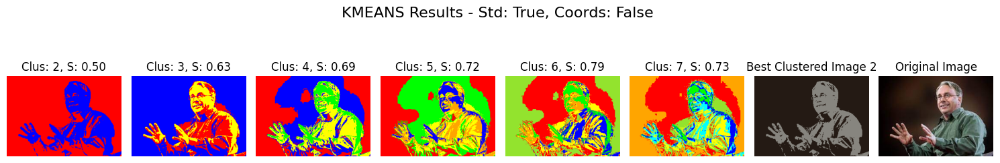

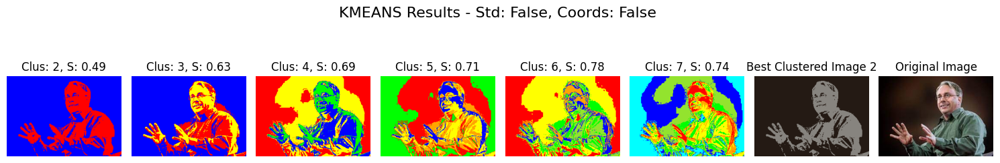

In [12]:
clustering_pipeline('4.jpg', algorithms = ['kmeans'])

### GMM
In the first row, the segmentation seems to be less accurate with bad scores. which shows a big difference between GMM and Kmeans at this case, when Kmeans captures the background correctly, GMM adds noise to the object itself. We also notice that in general there is no change between the results of the configuration without coordinates plus  with and without standardization. For this case, the main reason that the colors of the background is far away from the object itself.

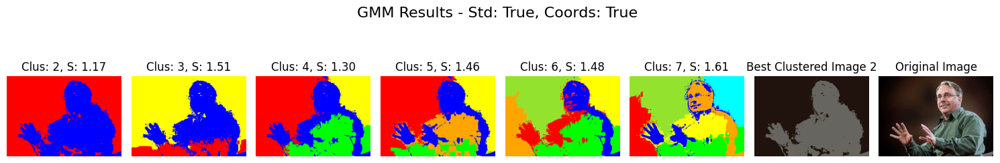

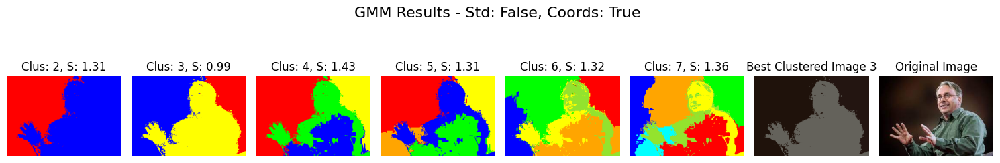

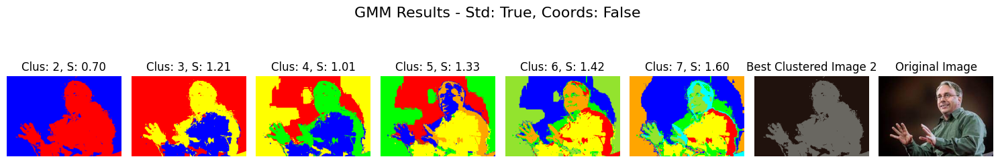

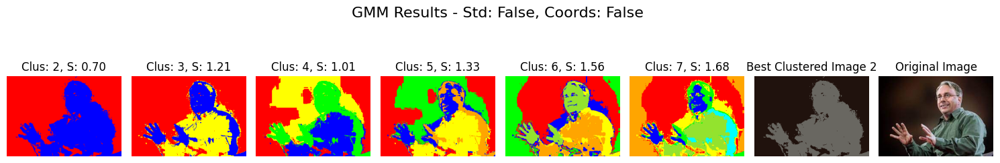

In [13]:
clustering_pipeline('4.jpg', algorithms = ['gmm'])

#### Silhouette
Here, the scores were the best for all algorithms with all configurations for 2 clusters. which is fair for Silhouette which quantifies both the compactness and the separation of clusters

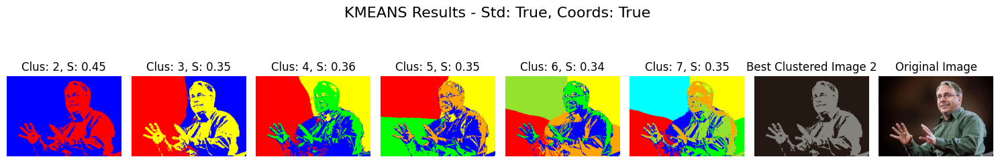

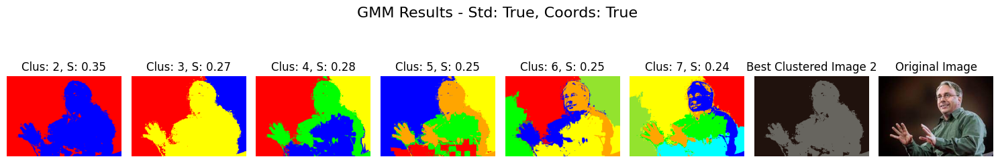

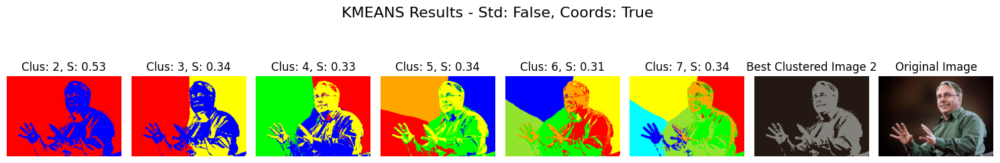

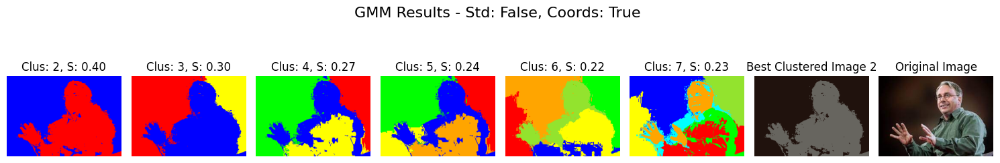

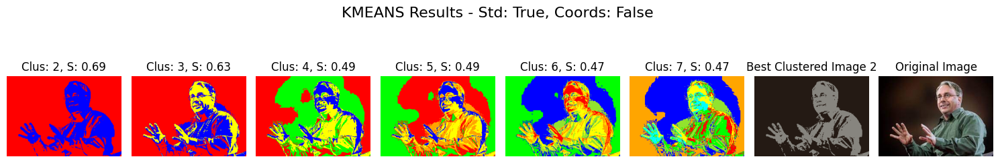

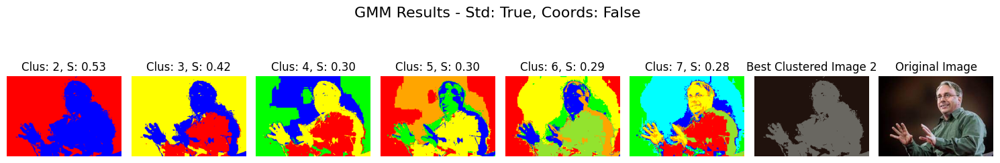

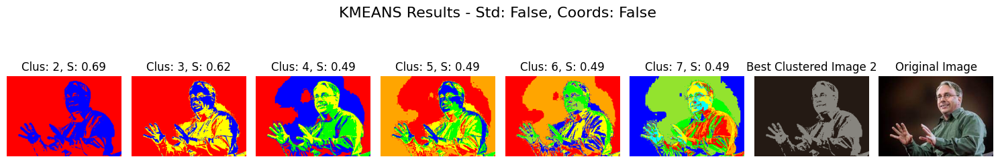

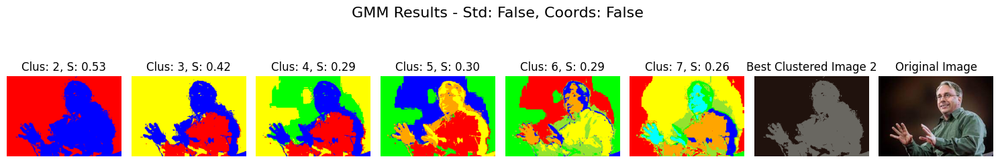

In [14]:
clustering_pipeline('4.jpg', metric=EvaluationMetric.SILHOUETTE)

## Fifth Image
### KMEANS
This image shows many people on one image, so we must add more clusters to the configuration. Clearly for all configuration we can see the model struggle in segmenting all the people, even if we have large number of clusters. But at least it separated the clusters of people and the flags not like GMM in the next section.

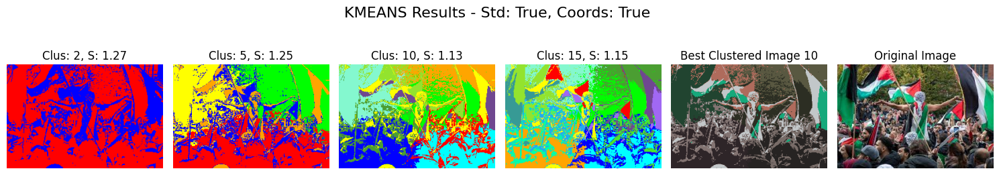

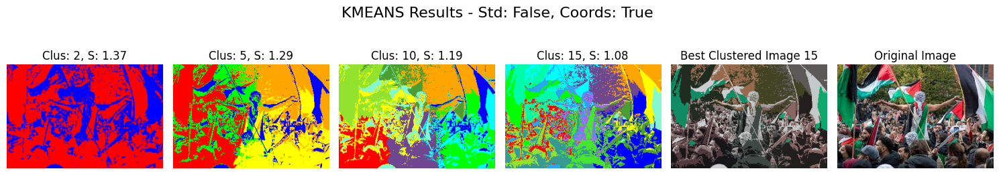

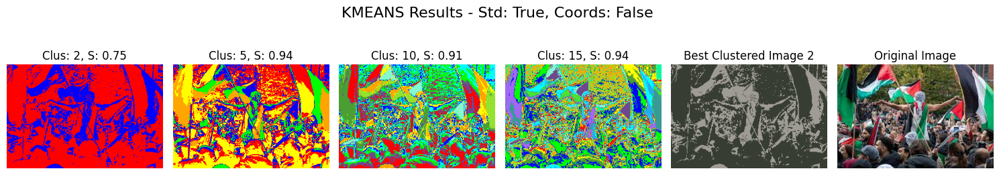

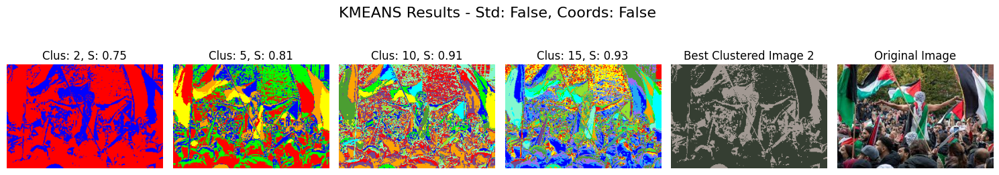

In [16]:
clustering_pipeline('5.jpg', algorithms = ['kmeans'], n_clusters_range = [2, 5, 10, 15])

## GMM
GMM model mixed up the people and the flags even if there are alot of clusters.

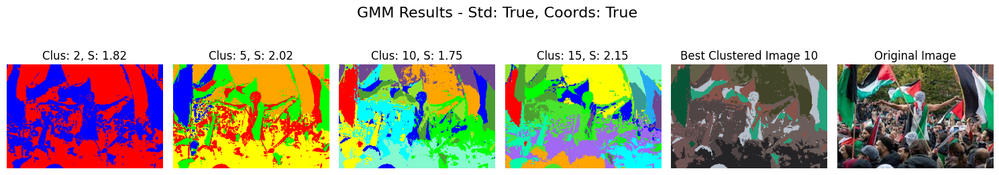

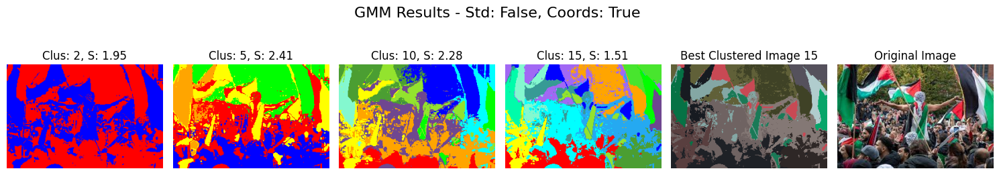

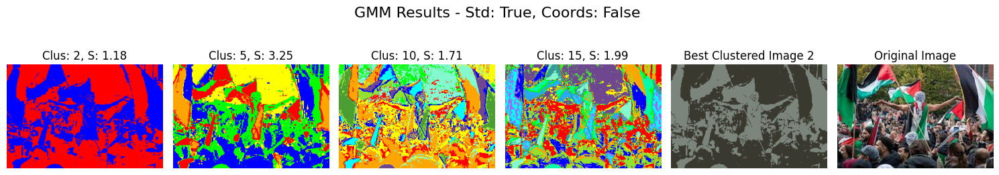

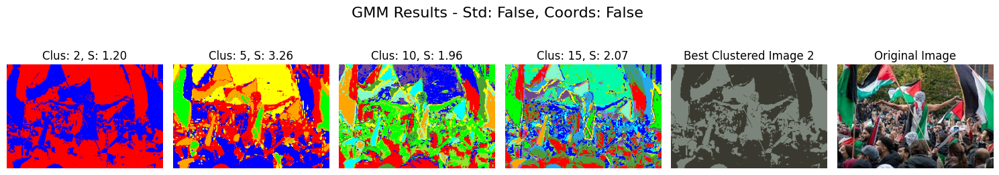

In [18]:
clustering_pipeline('5.jpg', algorithms = ['gmm'], n_clusters_range = [2, 5, 10, 15])

#### SILHOUETTE
We can see very low scores in this image as dicussed in previous section.

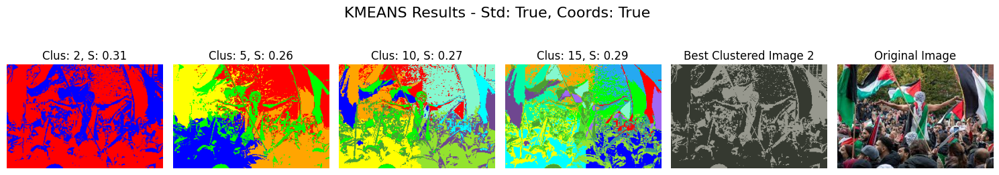

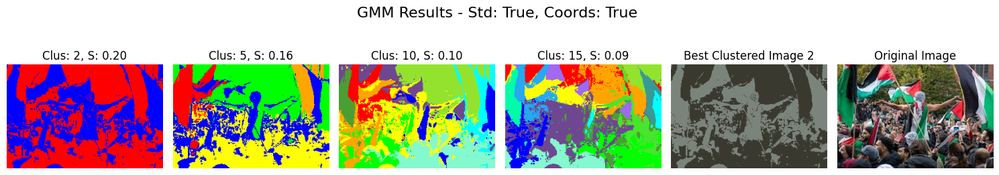

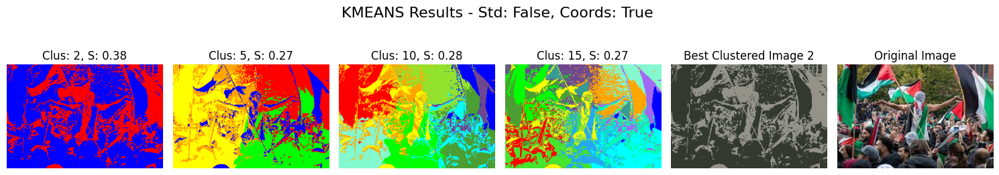

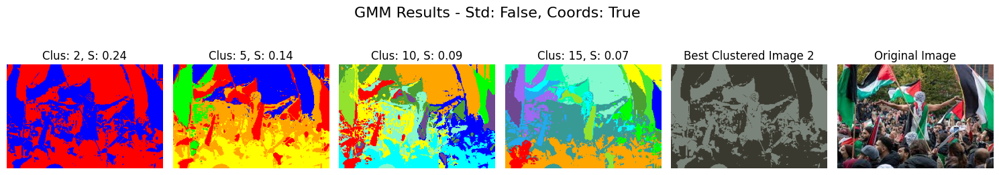

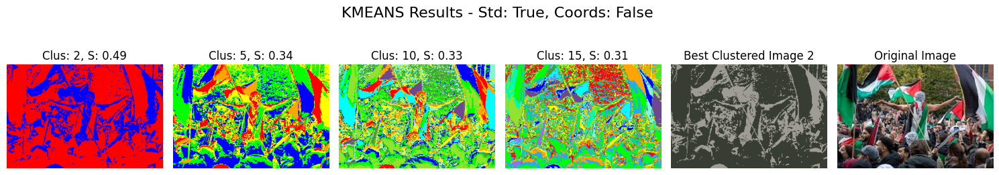

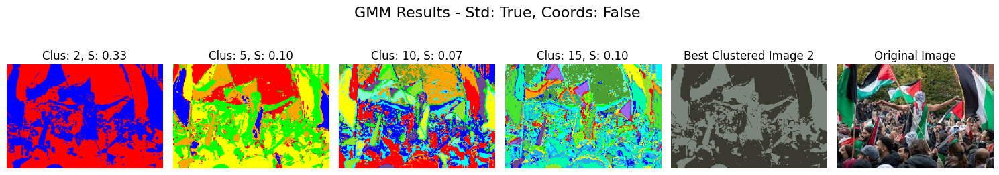

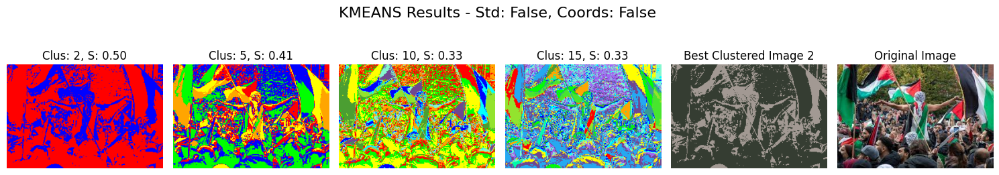

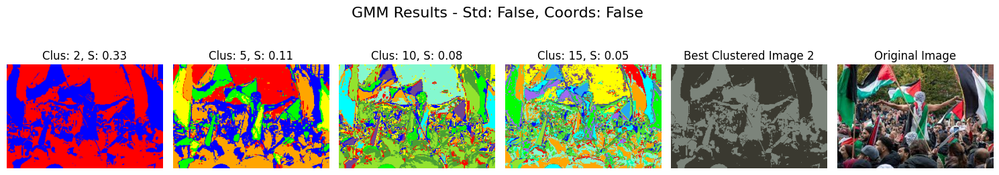

In [19]:
clustering_pipeline('5.jpg', metric=EvaluationMetric.SILHOUETTE, n_clusters_range = [2, 5, 10, 15])

## Sixth Image
The main objective of this image is to separate the river from the bridge and the buildings. It is a hard task where the bridge has the same lights of the building. For the first case we can see that the model separated all the objects from the sky and got the best results, but visually, three clusters was the best segmentation because it separated the river from the building and the sky. The second row segmented the image using coordination only which gave the best score to 7 cluster, but in reality all the clusters were bad. The third row shows a very better clustering with better scores but needs enhancement with exasperating the bridge from the building. The best scores were in the clusters that separates the bridge and the buildings from the river and the sky, like separating the background from the objects.

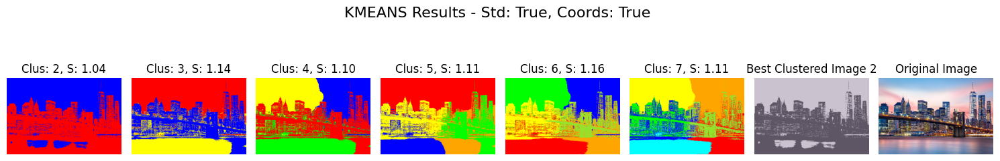

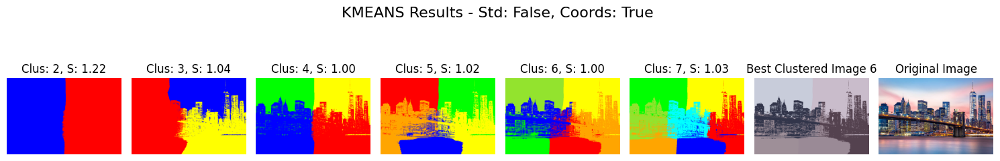

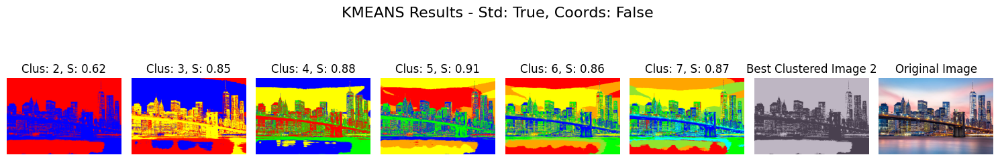

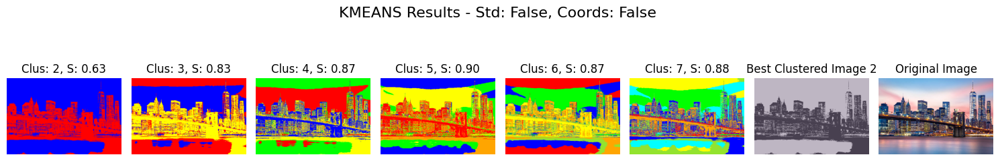

In [20]:
clustering_pipeline('6.jpg', algorithms = ['kmeans'])

### GMM
For GMM, the results was really bad as we can see below, the assumption of data being generated from Gaussian distributions doesn't hold, especially in images with sharp boundaries or non-Gaussian color distributions. Additionally, GMM's computational complexity and sensitivity to initialization can result in poorer performance on large, high-dimensional image data where K-means' simplicity and speed provide practical advantages.

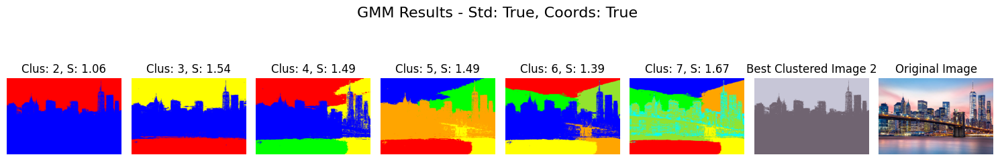

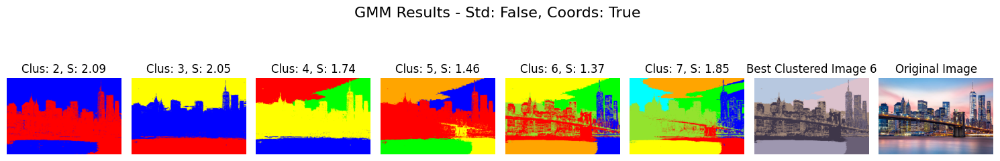

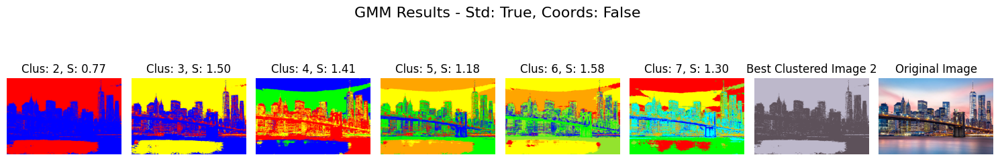

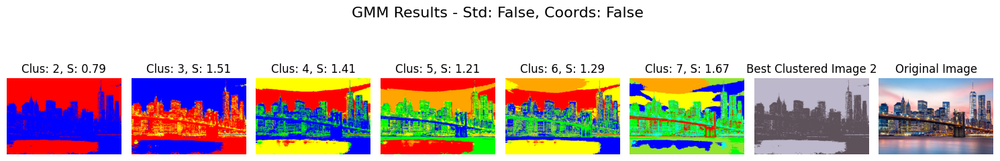

In [21]:
clustering_pipeline('6.jpg', algorithms = ['gmm'])

#### SILHOUETTE
SILHOUETTE gave better scores for 2 clusters, which sepeartes the objects from the background with the same reasons discussed previously.

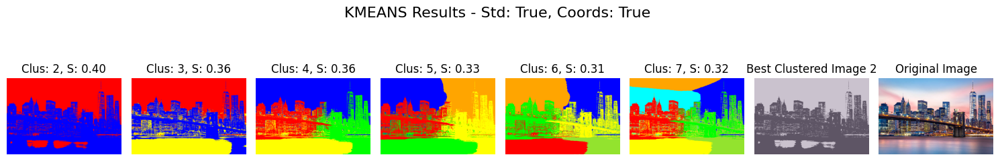

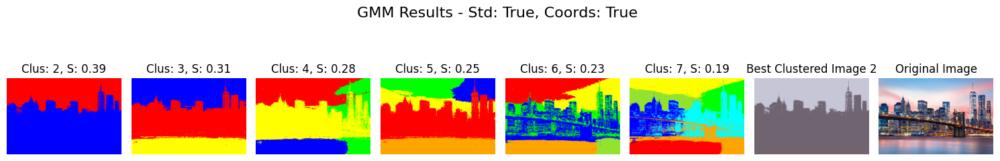

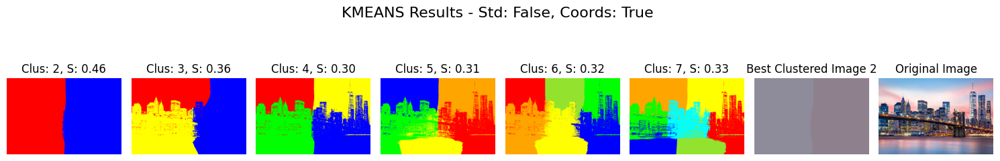

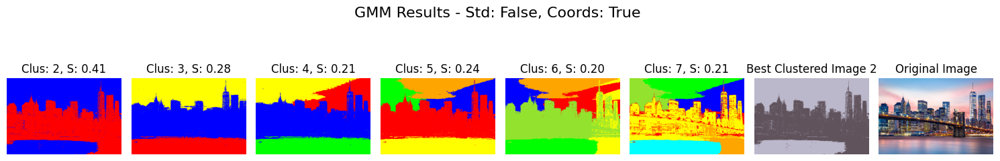

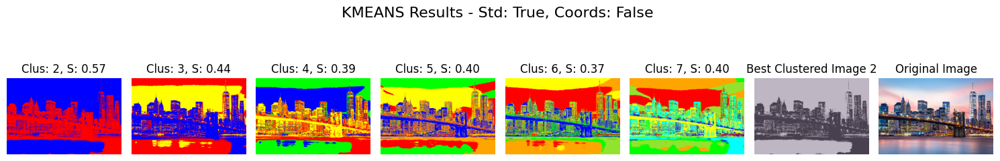

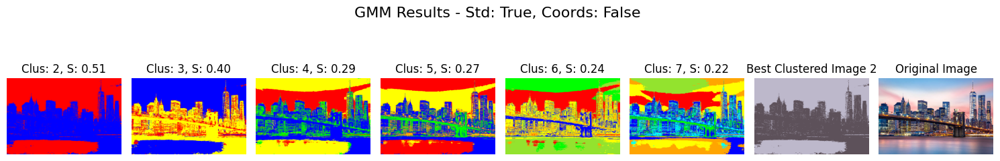

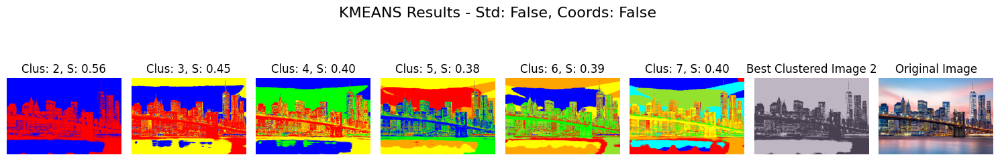

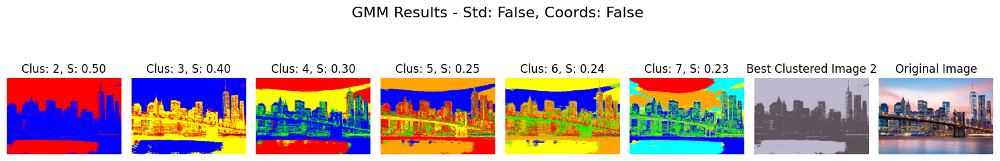

In [22]:
clustering_pipeline('6.jpg', metric=EvaluationMetric.SILHOUETTE)

## Seventh Image
For this image, the task is to seperate multiple objects from the background. For all results, the models cannot separate the clusters by discarding the background from the objects itself. 

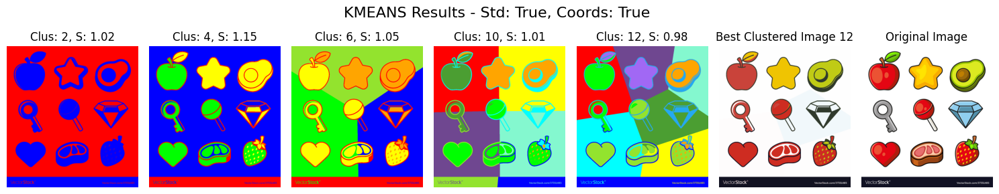

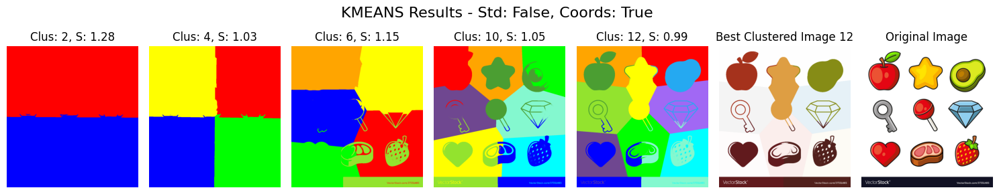

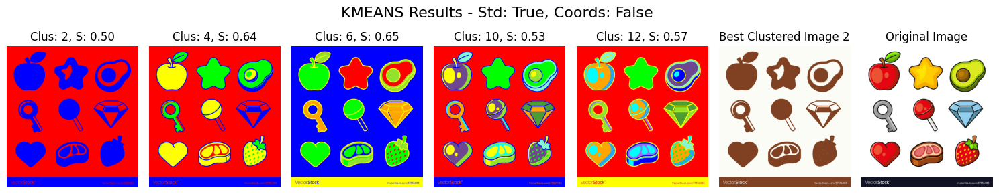

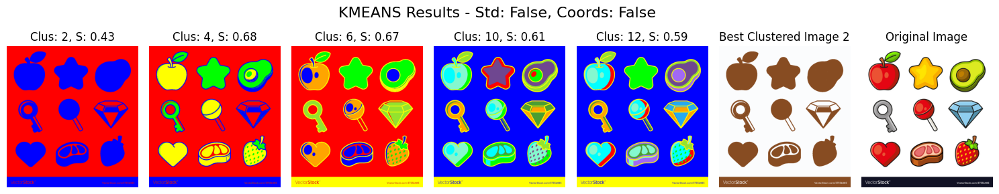

In [23]:
clustering_pipeline('7.jpg', algorithms = ['kmeans'], n_clusters_range = [2, 4, 6, 10, 12])

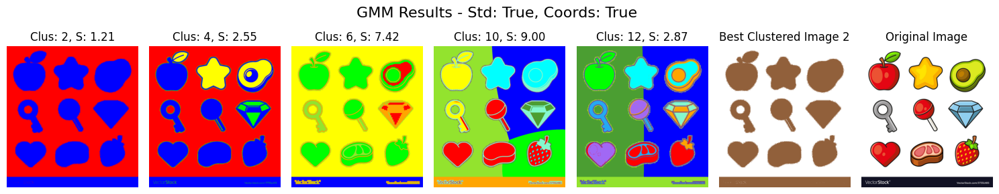

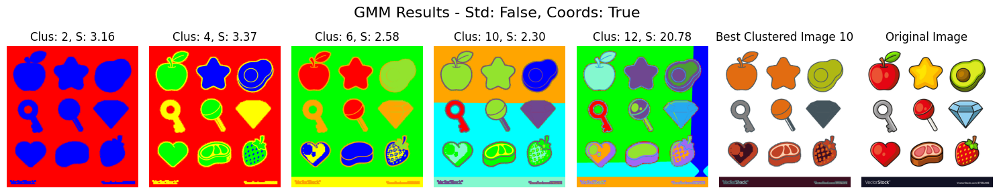

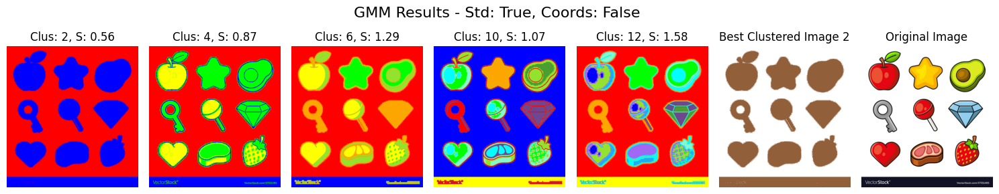

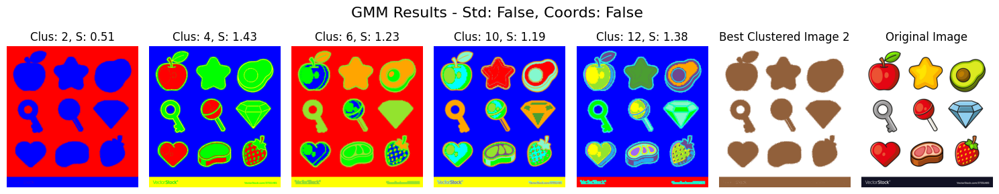

In [24]:
clustering_pipeline('7.jpg', algorithms = ['gmm'], n_clusters_range = [2, 4, 6, 10, 12])

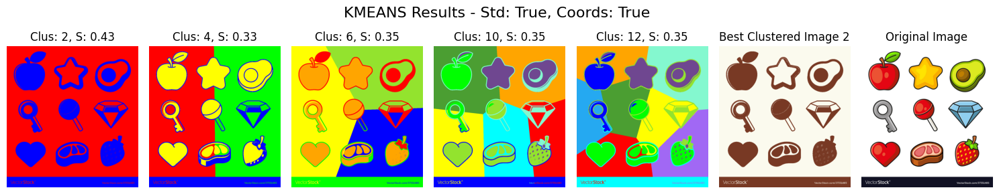

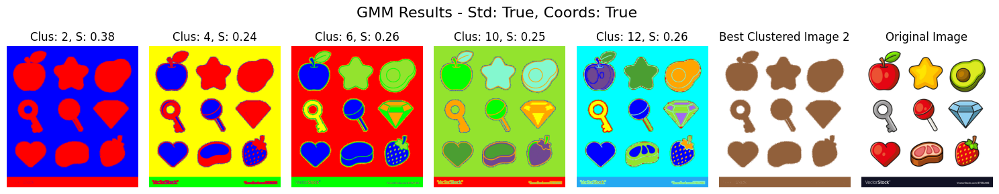

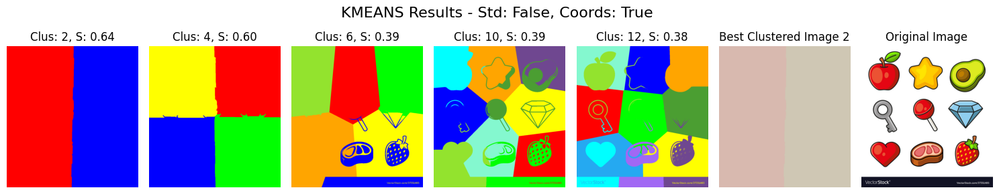

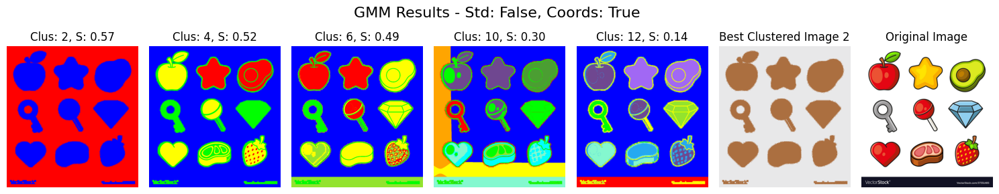

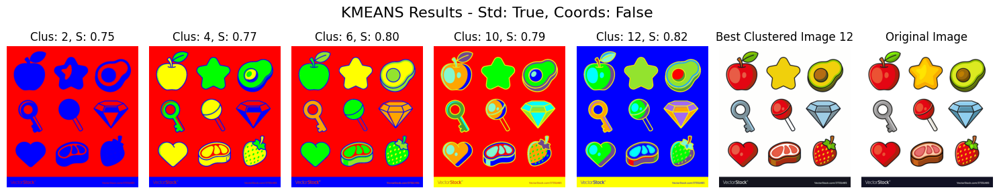

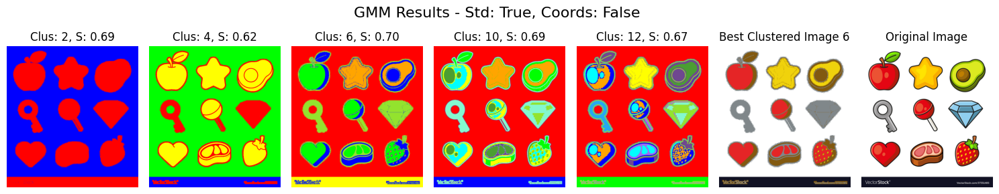

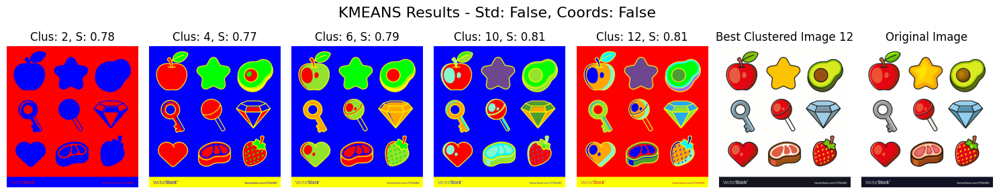

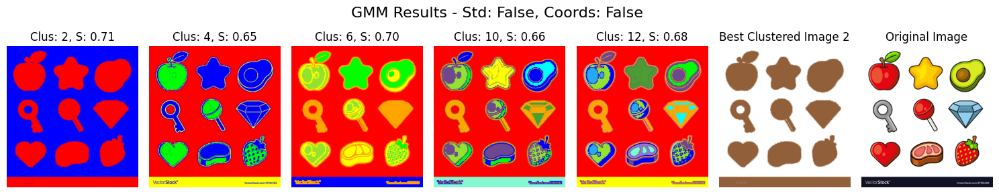

In [25]:
clustering_pipeline('7.jpg', metric=EvaluationMetric.SILHOUETTE, n_clusters_range = [2, 4, 6, 10, 12])

### Hierarchical Clustering
For this type of images, we will use Hierarchical clustering to seperate the background from the objects so we can get accurate results. For not using coordinations we got better results such that truly clustered the objectes here. Coordinates in such cases will mislead the model in clustering adding unwanted complexity. 

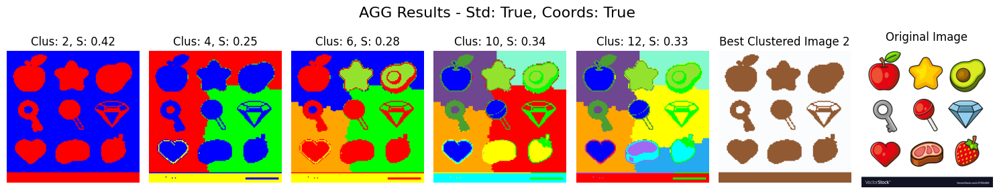

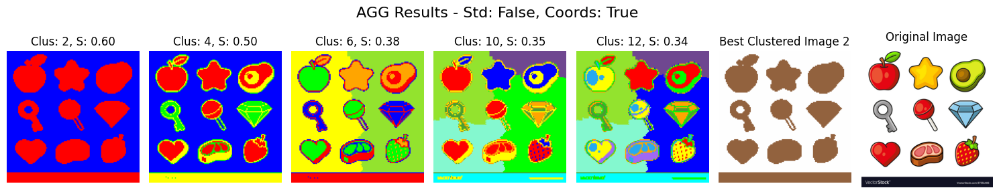

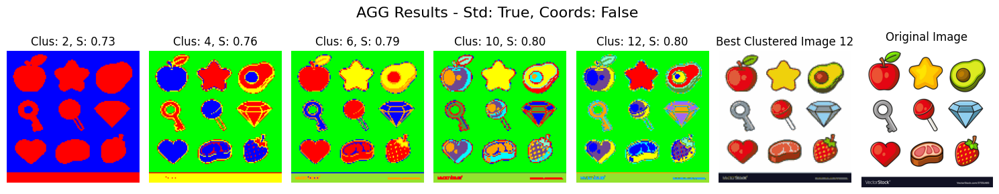

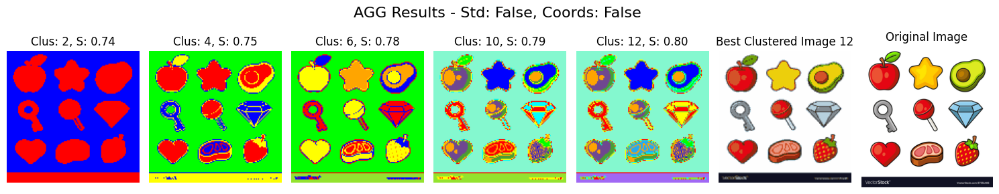

In [26]:
clustering_pipeline('7.jpg', algorithms=['agg'], metric=EvaluationMetric.SILHOUETTE, n_clusters_range = [2, 4, 6, 10, 12])

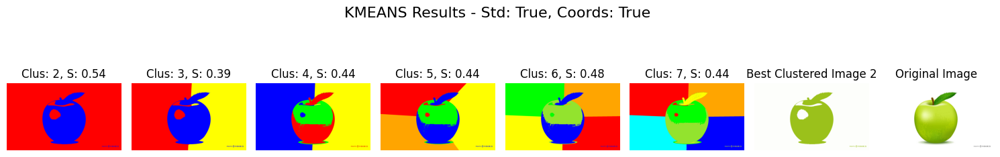

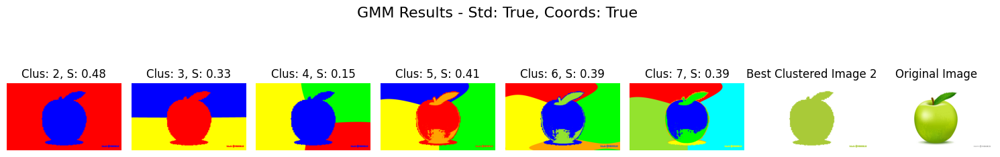

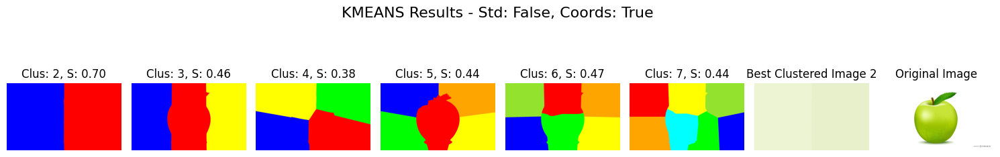

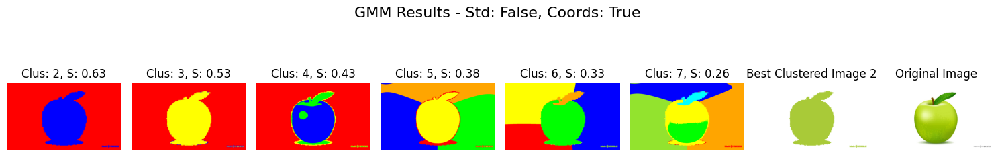

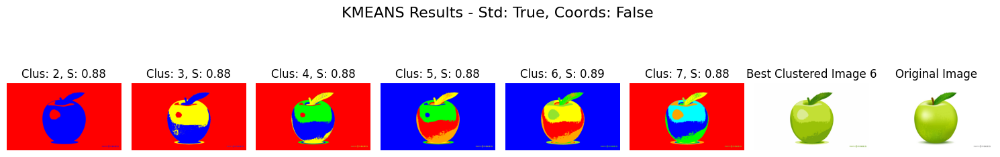

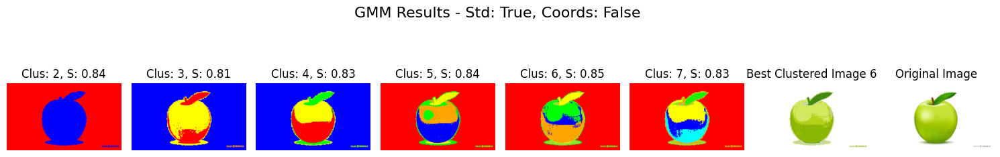

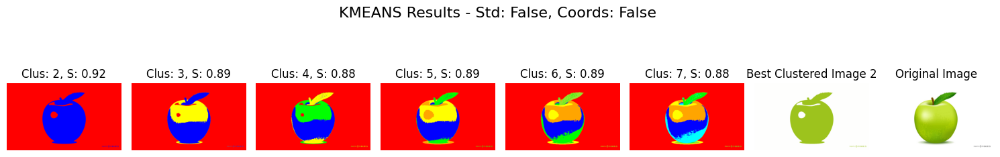

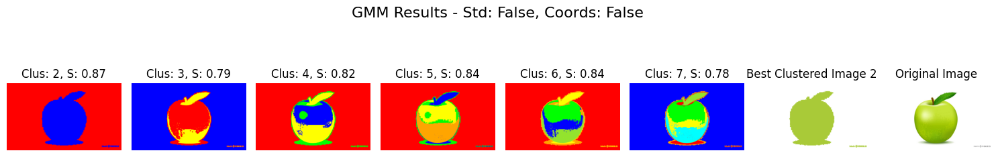

In [27]:
clustering_pipeline('8.jpg', metric=EvaluationMetric.SILHOUETTE)

## Using Hierarchical

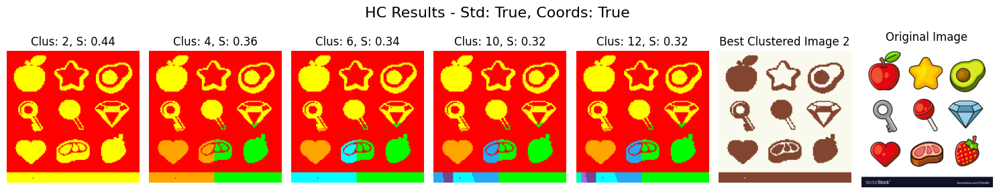

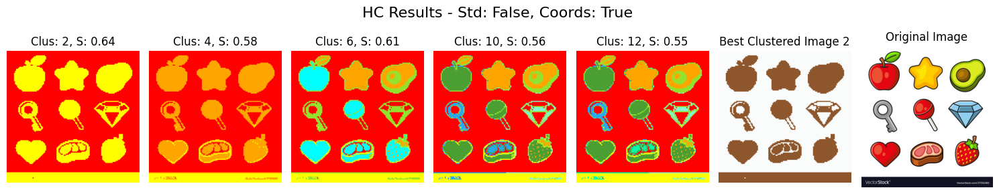

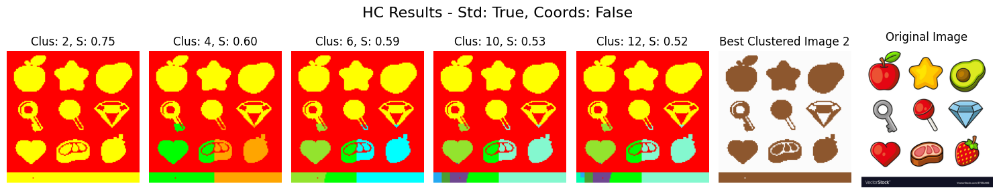

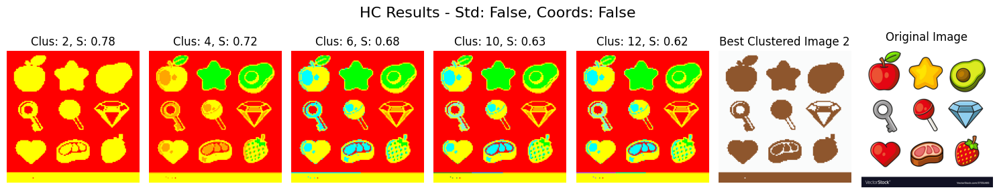

In [28]:
clustering_pipeline('7.jpg', algorithms=['hc'], metric=EvaluationMetric.SILHOUETTE, n_clusters_range = [2, 4, 6, 10, 12])

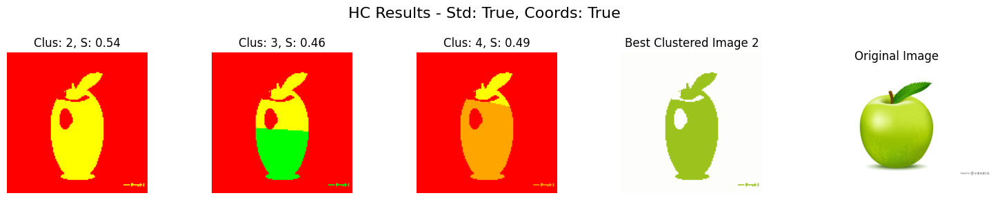

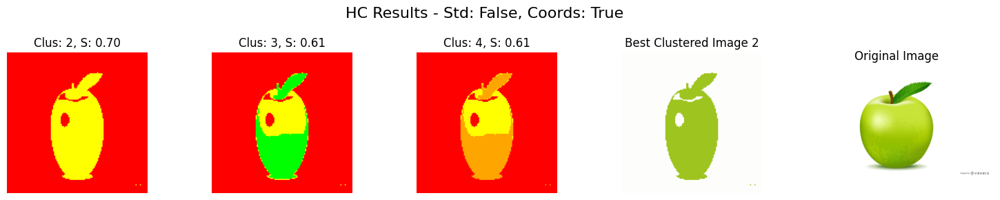

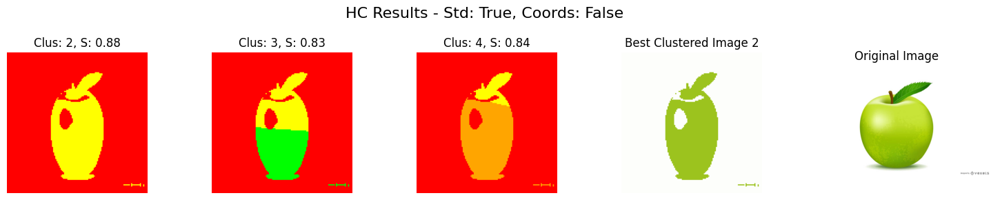

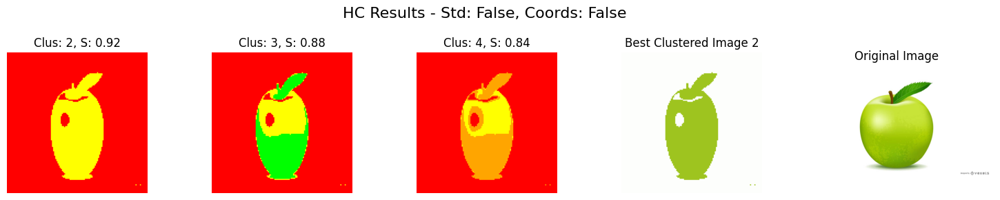

In [29]:
clustering_pipeline('8.jpg', algorithms=['hc'], metric=EvaluationMetric.SILHOUETTE, n_clusters_range = [2, 3, 4])

## Sheeps ;)


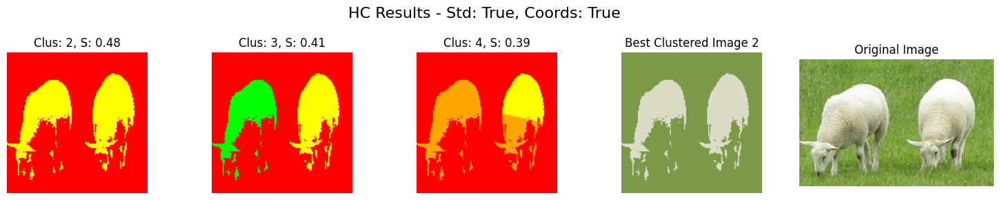

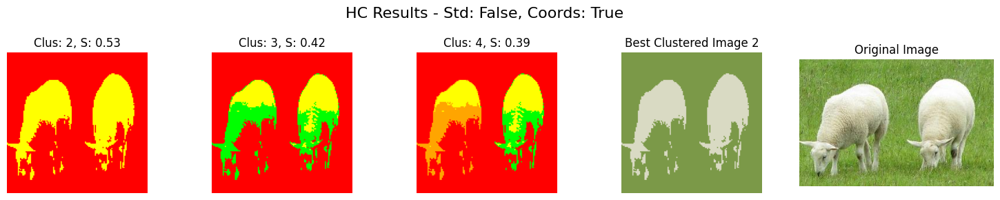

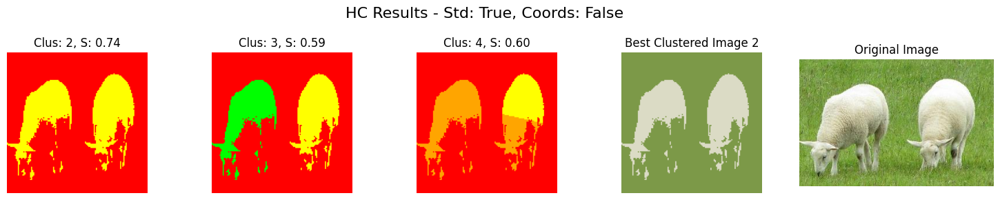

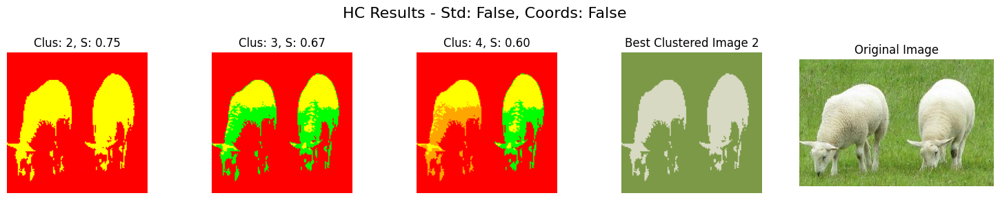

In [30]:
clustering_pipeline('10.jpg', algorithms=['hc'], metric=EvaluationMetric.SILHOUETTE, n_clusters_range = [2, 3, 4])

## Using DBSCAN
DBSCAN (Density-Based Spatial Clustering of Applications with Noise) is a popular clustering algorithm renowned for its proficiency in identifying clusters of arbitrary shapes and sizes, distinguishing it from methods like K-means and Gaussian Mixture Models (GMM). One of its strengths lies in effectively separating background elements from objects in an image, which is particularly useful in image segmentation tasks. However, finding the optimal parameters for DBSCAN, namely `eps` (epsilon) and `min_samples`, can be challenging. The `eps` parameter, which defines the maximum distance between two samples for them to be considered as in the same neighborhood, and `min_samples`, which sets the minimum number of samples in a neighborhood for a point to be considered as a core point, require careful tuning to achieve desired results.

In [31]:
from DBSCAN import ImageSegmentation
import numpy as np
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN
from itertools import product
import matplotlib.pyplot as plt

In [32]:
import numpy as np
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt

def dbscan_pipelines(image_path, min_samples_values=[250, 280, 300], neighbors=3, num_of_eps=5):
    original_image = plt.imread(image_path) 

    for value in [True, False]:
        image_segmenter = ImageSegmentation(image_path, resize_dims=(150, 150), augment_with_coordinates=value)
        initial_eps = image_segmenter.estimate_eps_using_derivative(n_neighbors=neighbors)
        eps_values = np.linspace(initial_eps * 0.75, initial_eps * 1.4, num_of_eps)

        for min_samples in min_samples_values:
            fig, axs = plt.subplots(1, len(eps_values) + 2, figsize=(20, 3)) 
            fig.suptitle(f"DBSCAN Results - Min Samples: {min_samples}, Augment with Coords: {value}", fontsize=16)

            best_score = -1
            best_params = None
            best_image = None

            for j, eps in enumerate(eps_values):
                db = DBSCAN(eps=eps, min_samples=min_samples).fit(image_segmenter.image)
                if len(set(db.labels_)) > 1:
                    score = silhouette_score(image_segmenter.image, db.labels_)
                    labels = db.labels_.reshape(image_segmenter.resize_dims) 

                    if score > best_score:
                        best_score = score
                        best_params = {'eps': eps, 'min_samples': min_samples, 'augment_with_coordinates': value}
                        best_image = labels

                    axs[j].imshow(labels, cmap='viridis')
                    axs[j].set_title(f"Eps: {eps:.2f}, Score: {score:.2f}")
                    axs[j].axis('off')

            axs[len(eps_values)].imshow(best_image, cmap='viridis')
            axs[len(eps_values)].set_title(f"Best Segmented Image")
            axs[len(eps_values)].axis('off')

            axs[len(eps_values) + 1].imshow(original_image)
            axs[len(eps_values) + 1].set_title("Original Image")
            axs[len(eps_values) + 1].axis('off')

            plt.tight_layout(rect=[0, 0.03, 1, 0.95])
            plt.show()


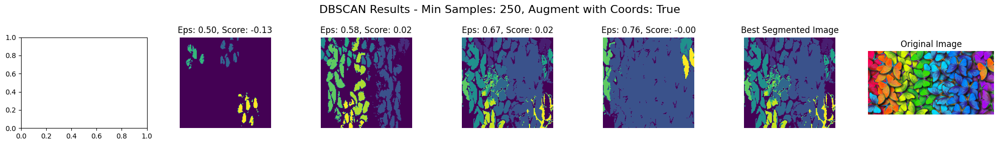

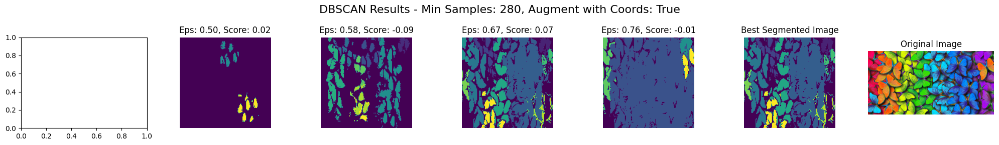

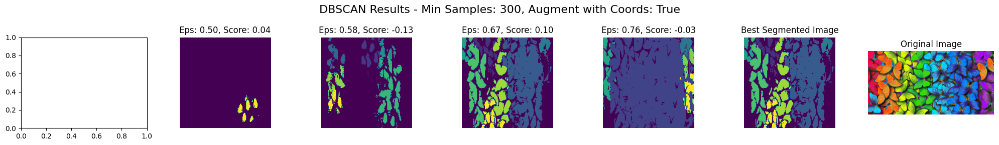

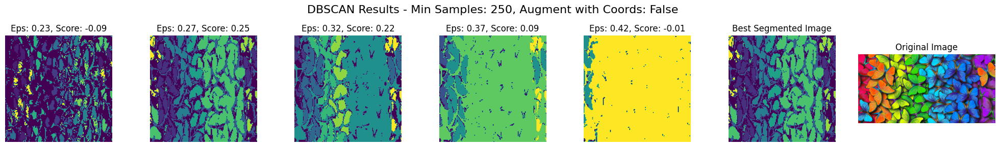

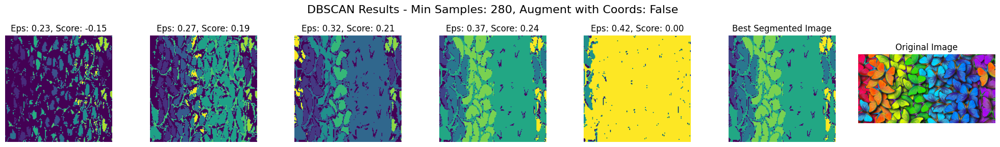

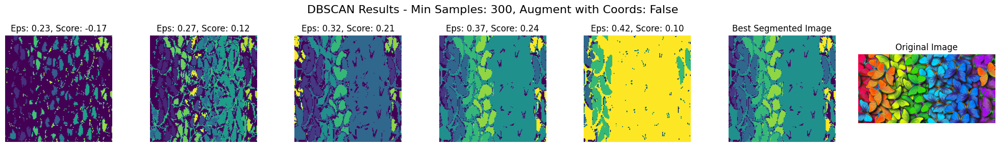

In [33]:
dbscan_pipelines('1.jpg', min_samples_values = [250, 280, 300])

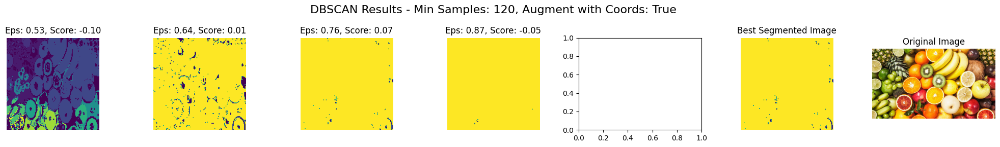

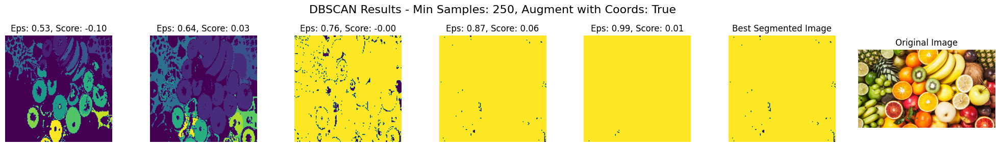

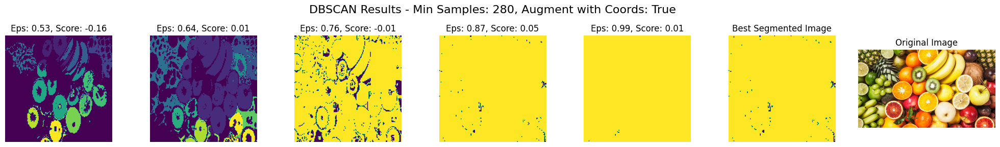

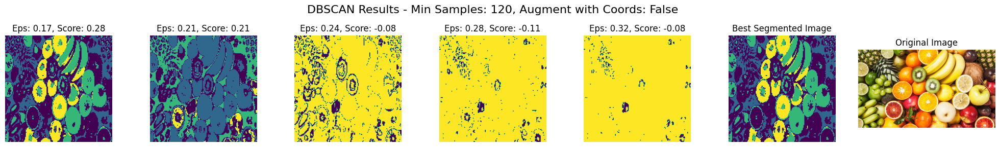

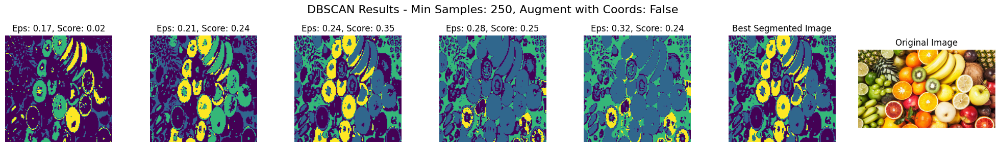

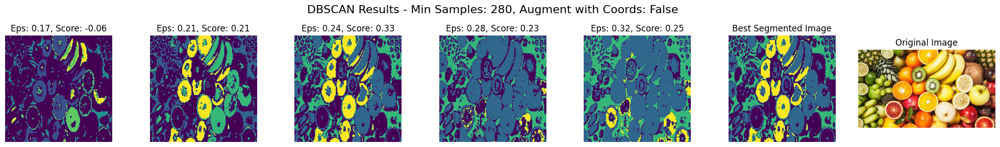

In [34]:
dbscan_pipelines('2.jpg', min_samples_values = [120, 250, 280])

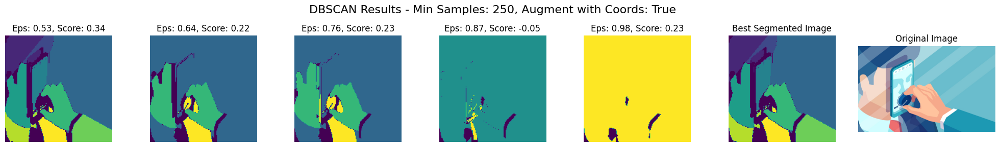

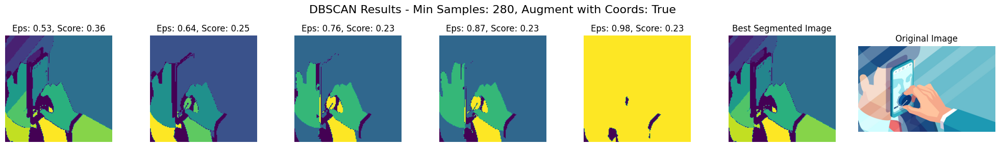

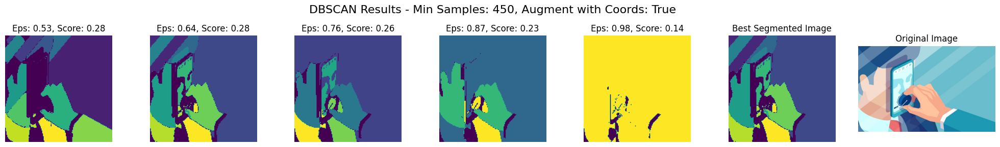

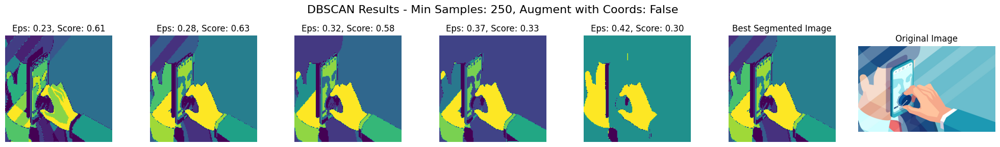

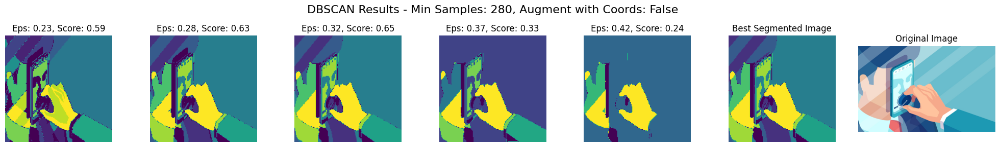

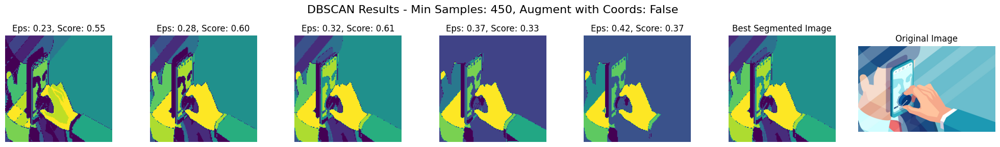

In [35]:
dbscan_pipelines('3.jpg', min_samples_values = [250, 280, 450])

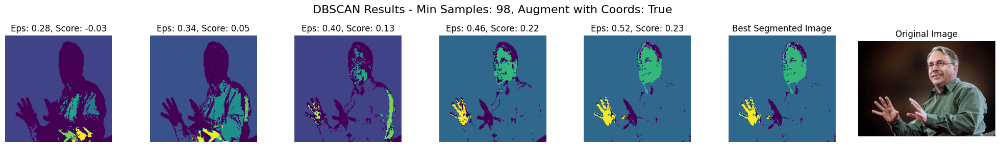

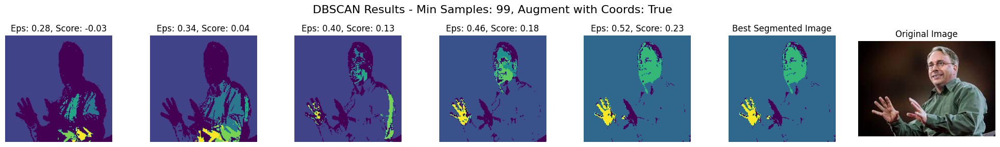

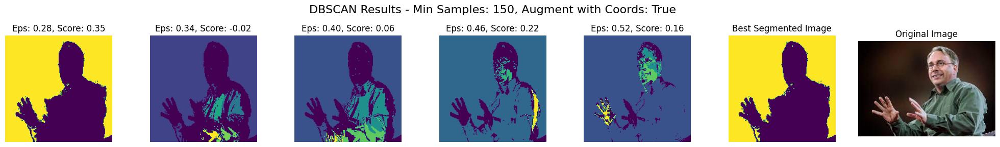

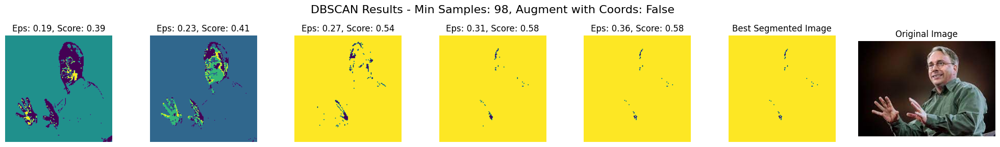

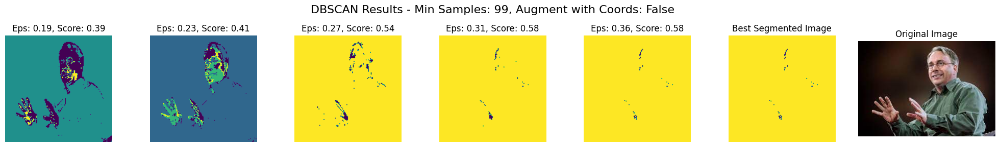

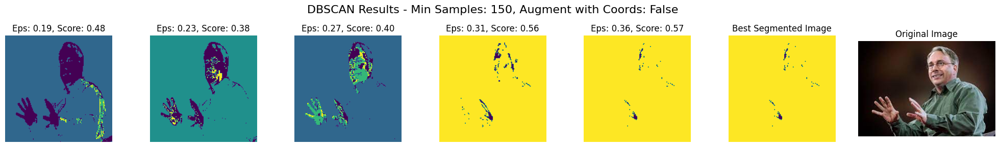

In [36]:
dbscan_pipelines('4.jpg', min_samples_values = [98, 99, 150], neighbors=2, num_of_eps=5)

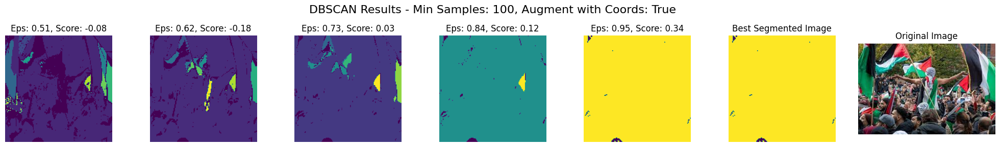

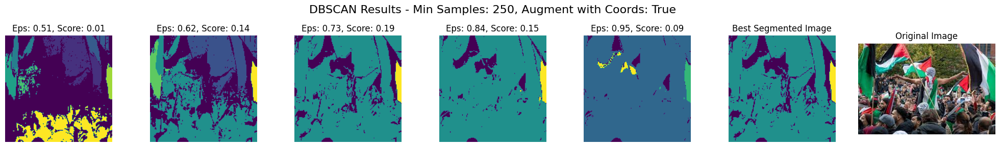

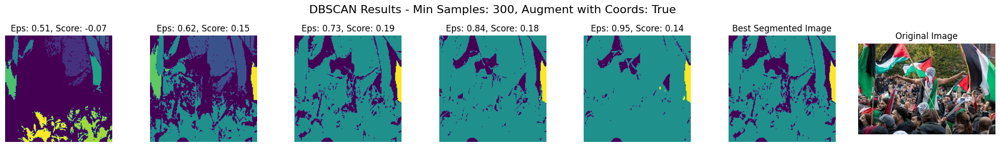

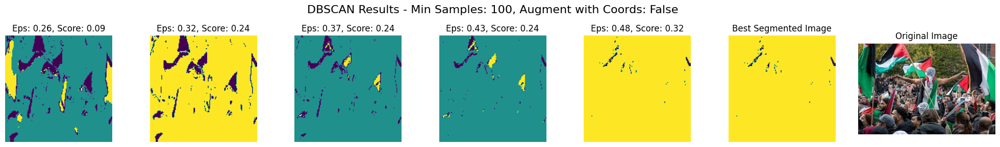

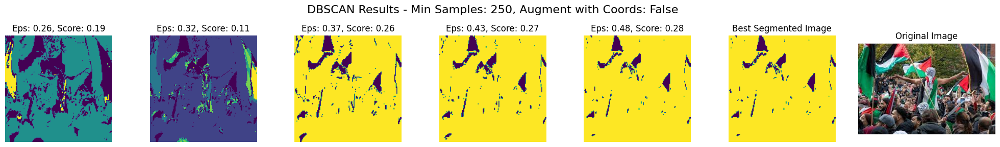

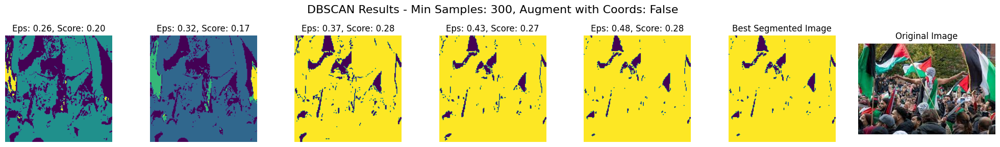

In [37]:
dbscan_pipelines('5.jpg', min_samples_values = [100, 250, 300])

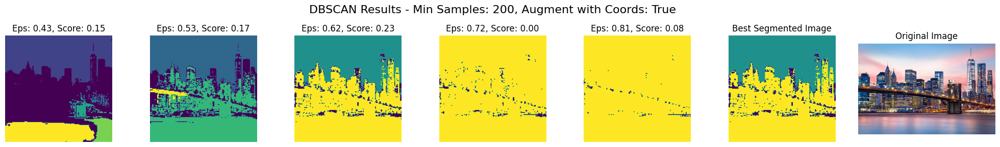

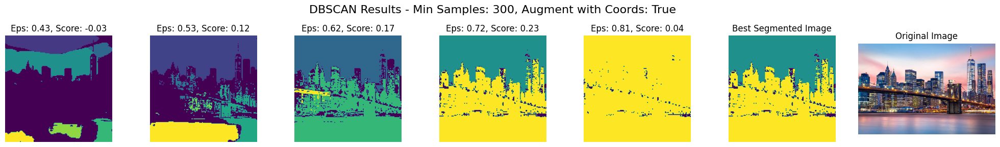

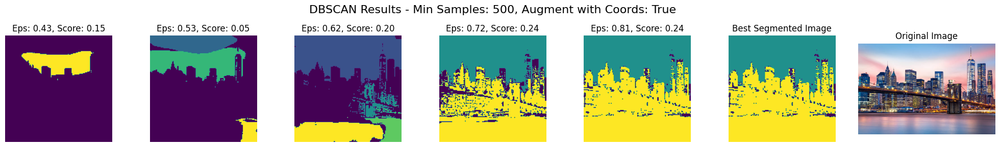

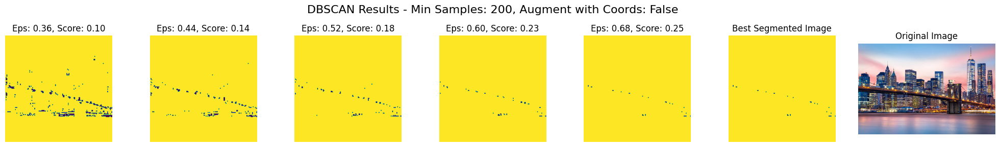

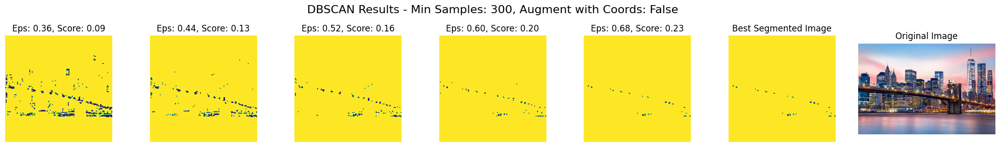

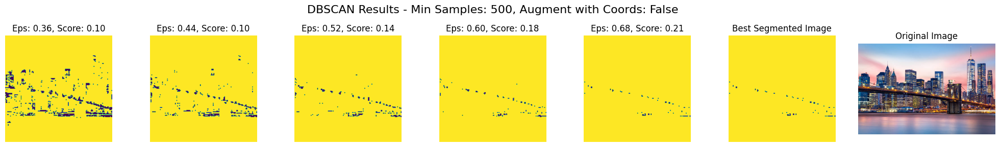

In [38]:
dbscan_pipelines('6.jpg', min_samples_values = [200, 300, 500])

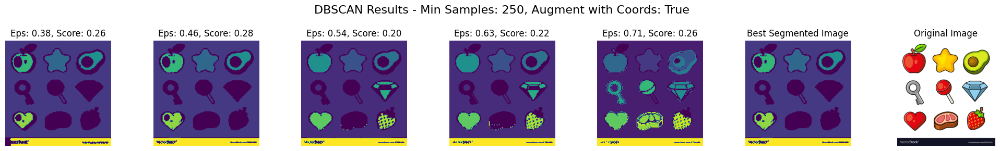

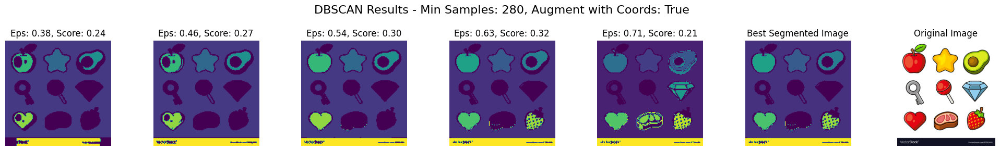

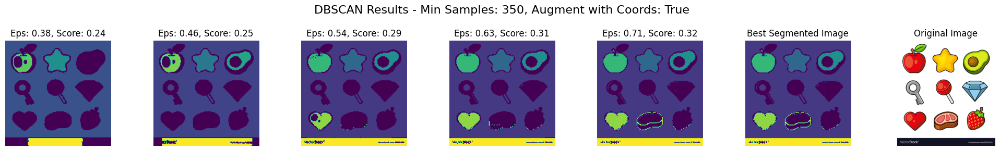

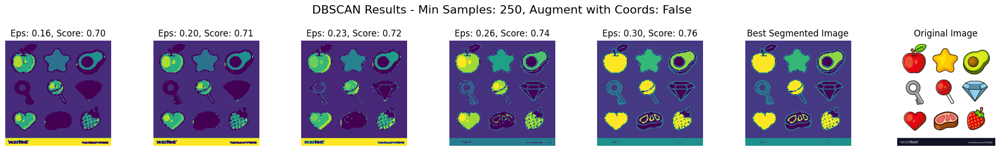

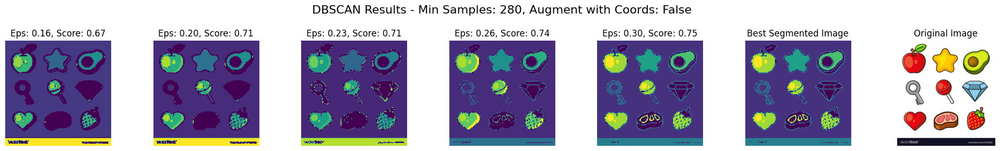

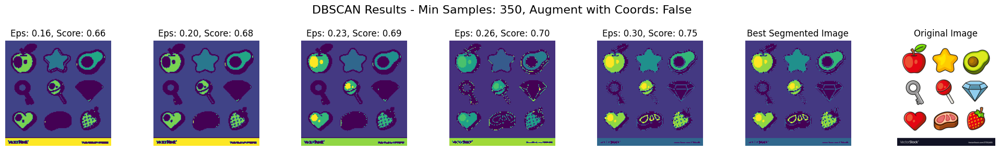

In [39]:
dbscan_pipelines('7.jpg', min_samples_values = [250, 280, 350])

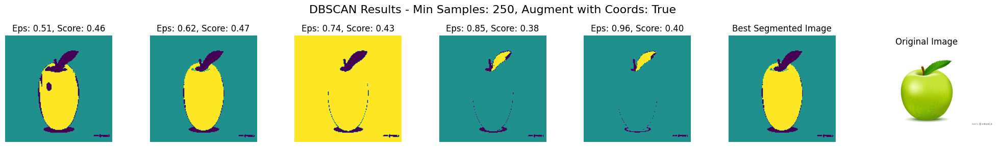

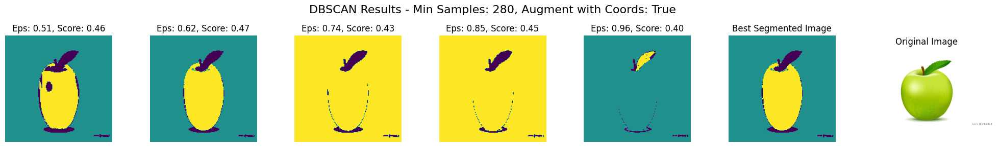

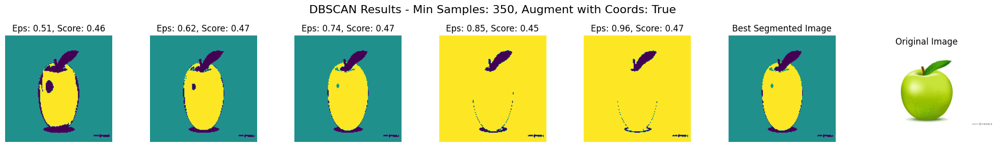

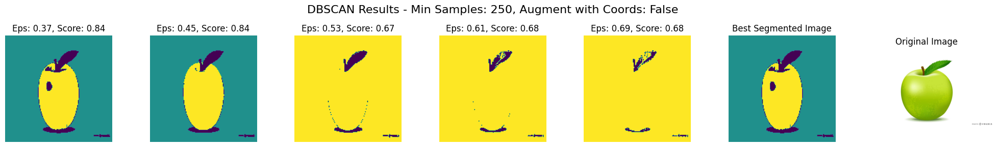

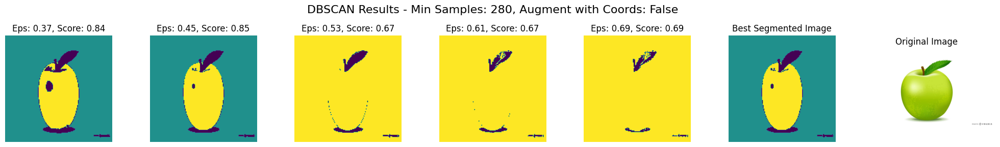

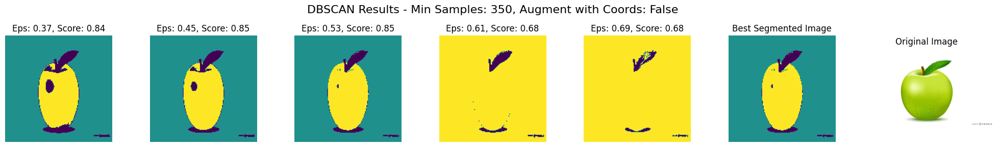

In [40]:
dbscan_pipelines('8.jpg', min_samples_values = [250, 280, 350])

DBSCAN is good at telling background and important objects apart in images because it looks at how things are spread out, which is different from other methods like K-means and GMM. It's great for images where the background and objects have different levels of detail. But, DBSCAN can have trouble with complicated patterns, especially when the spread of details changes a lot. It relies heavily on two settings, `eps` and `min_samples`, to work well. If these aren't chosen right, DBSCAN might mix up different clustersor split them wrongly. While it's good for some jobs, like separating background from important parts, it's not always the best choice for images with complex and uneven patterns.

# Main Results

This case study explored the effectiveness of various clustering algorithms - K-means, GMM, and DBSCAN - across different images. Key findings include:

1. **K-means** is versatile but struggles with overlapping colors and benefits from the inclusion of coordinates in certain scenarios.
2. **GMM** excels in identifying mixed clusters, especially in images with intricate light patterns or where standardization is not applied.
3. **DBSCAN** is effective in separating background from foreground but requires careful tuning of parameters.
4. **Silhouette Scores** often provided more accurate assessments, particularly for images with overlapping clusters.

Overall, the choice of algorithm and parameters significantly impacts segmentation quality, with each algorithm exhibiting unique strengths in different scenarios.

| Scenario/Image | Description                                                          | K-means Observations                                                      | GMM Observations                                                             | DBSCAN Observations                                                         | Metrics                                                               |
|----------------|----------------------------------------------------------------------|---------------------------------------------------------------------------|------------------------------------------------------------------------------|-----------------------------------------------------------------------------|-----------------------------------------------------------------------|
| First Image    | A colorful and pattern-rich image.                                   | Struggles with overlapping colors, better without augmenting coordinates. | Better at mixed clusters; standardization has less effect.                   | Struggled on the mixed colors                                               | Silhouette was better on describing the performance.                  |
| Third Image    | More consistent colors, less overlap.                                | Standardization enhance the performance, struggled on getting the light.  | Captures details like light rays effectively.                                | Better Performance and scores on getting the details                        | Silhouette was better on getting the efficiency of extracting details |
| Fourth Image   | Task of separating background from the main object (Linus Torvalds). | Separates background well                                                 | Less accurate segmentation; struggles with backgrounds.                      | Got the background correctly without the object; Needs more tuning          | Silhouette always gave the best score to the 2 clusters               |
| Fifth Image    | Image with many people, requiring more clusters.                     | Struggles with complex scenarios like clusters.                             | Mixes elements, e.g., people and flags.                                      | Same issues                                                                 | Low scores due to complexity for both metrics.                        |
| Sixth Image    | Objective to separate river from bridge and buildings.               | Better at separating river and buildings; coordinates less critical.      | Poor performance, struggles with sharp boundaries and didn't got the bridge. | Separated the river from the other object. Bad in general.                  | Both favors simpler separations like background vs. objects.          |
| Seventh Image  | Task to separate multiple objects from the background.               | Unable to separate all objects effectively. better without coordinates    | Good in isolating the background not the objects.                            | Better in general, identified similar objects with better scores in general | Silhouette gave better scores for outputs with multiple clusters.     |


---
The Silhouette method and DBSCAN each have their unique strengths and challenges in clustering tasks. The Silhouette method, while effective in assessing cluster separation, faces practical limitations in large datasets due to its high time complexity. It calculates distances extensively, making it less suitable for big or real-time data. On the other hand, DBSCAN, known for its ability to identify clusters of various shapes and sizes, also becomes complex with large datasets. Its performance heavily depends on the correct choice of parameters, `eps` and `min_samples`, which can be challenging to determine and greatly affect the clustering outcome. Both methods offer valuable insights but have constraints that influence their applicability in different scenarios.

In comparing the performance of K-means and GMM across various scenarios, it's evident that each algorithm has its strengths. K-means shows difficulty with overlapping colors and performs better without coordinate augmentation, particularly in pattern-rich images. It excels in separating backgrounds but struggles with complex texture scenarios. On the other hand, GMM is superior in handling mixed clusters and capturing intricate details like light rays, although it sometimes struggles with accurate segmentation in complex backgrounds. Both algorithms face challenges in scenarios with many elements or in images requiring detailed separation, such as separating a river from buildings. Overall, K-means tends to be more effective in simpler segmentation tasks, while GMM shows advantages in more detailed and complex scenarios.